# Example of using Re-Project package to homogeneize Instrument viewpoint

The most strict combination of our HR data and HMI would require a perfect spatial mapping between instruments, which is beyond the scope of our project.  However, a reasonable match between them can be achieved using the re-project package.  This notebook shows an example of this. 

### Remove scroll from figures

In [1]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

### Extend the size of the Window

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
import numpy as np
from astropy.io import fits
import matplotlib.pylab as plt
import matplotlib as mpl
import pandas as pd
from sunpy.map import Map
import astropy.units as u
from reproject import reproject_exact, reproject_interp #use reproject_interp if you want it done quicker.

from scipy.ndimage import fourier_shift, gaussian_filter


from astropy.time import Time
from astropy.coordinates import solar_system_ephemeris, EarthLocation
from astropy.coordinates import get_body_barycentric, get_body, get_moon

from datetime import datetime
from sunpy.net import Fido, vso, attrs as a
import drms

from sklearn.feature_extraction import image
import tensorflow as tf

from skimage.feature import register_translation
from skimage.feature import match_template

import cv2

import glob
from tqdm import tqdm

In [4]:
print("Using TensorFlow version %s" % tf.__version__)

Using TensorFlow version 2.6.0


### Define colors an colormaps

In [5]:
# Color Axis limits
vmin = -2000
vmax = 2000

# Color definitions
ClrS = (0.74, 0.00, 0.00)
ClrN = (0.20, 0.56, 1.00)

Clr = [(0.00, 0.00, 0.00),
      (0.31, 0.24, 0.00),
      (0.43, 0.16, 0.49),
      (0.32, 0.70, 0.30),
      (0.45, 0.70, 0.90),
      (1.00, 0.82, 0.67)]

# Colormap Definition
# current_cmap = plt.cm.get_cmap('hmimag')
current_cmap = plt.cm.get_cmap('seismic')
current_cmap.set_bad(color='black')

C:\Users\Andres\AppData\Local\Temp/ipykernel_21252/4275249956.py:19: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("seismic").copy()
  current_cmap.set_bad(color='black')


---

## Specify paths and load index match file

In [6]:
email = 'amunozj@boulder.swri.edu'
export_protocol = 'fits'
data_folder = 'D:/Mis Documentos/AAResearch/Codes/MDI to HMI doppler/Data/'

year_s = 2010
month_s = 6
day_s = 1
hour_s = 23
minute_s = 46
second_s = 0


year_e = 2010
month_e = 6
day_e = 1
hour_e = 23
minute_e = 49
second_e = 15

## Define utility functions

In [7]:
def get_patch(amap, size, stride=None):
    """
    create patches of dimension size * size with a defined stride.
    If the stride is equals to size, there is no overlap

    Parameters
    ----------
    amap: sunpy map

    size: integer
        size of each patch

    Keywords
    --------
    stride: integer
        Size of the stride

    Returns
    -------
    numpy array [num_patches, num_channel, size, size]
        channels are magnetic field, radial distance relative to radius

    """
    if stride is None:
        stride = size

    x, y = np.meshgrid(*[np.arange(v.value) for v in amap.dimensions]) * u.pixel
    hpc_coords = amap.pixel_to_world(x, y)
    array_radius = np.sqrt(hpc_coords.Tx ** 2 + hpc_coords.Ty ** 2) / amap.rsun_obs

    patches = image.extract_patches_2d(amap.data, (size, size))
    patches = patches.reshape([-1] + list((size, size)))

    patches_r = image.extract_patches_2d(array_radius, (size, size))
    patches_r = patches_r.reshape([-1] + list((size, size)))

    return np.stack([patches, patches_r], axis=1)

## Download GONG

In [8]:
# client = vso.VSOClient()
# results = client.search(
#    a.Time(datetime(year_s, month_s, day_s, hour_s, minute_s, second_s), datetime(year_e, month_e, day_e, hour_e, minute_e, second_e)),
#    a.Instrument.mergedgong, a.Physobs.los_velocity, 
#    response_format="table")

# downloaded_files = client.fetch(results, path=data_folder + 'GONG/{file}')

## Download MDI

In [9]:
# results = Fido.search(a.Time(f'{year_s}-{str(month_s).zfill(2)}-{str(day_s).zfill(2)}T{str(hour_s).zfill(2)}:{str(minute_s).zfill(2)}:{str(second_s).zfill(2)}', 
#                          f'{year_e}-{str(month_e).zfill(2)}-{str(day_e).zfill(2)}T{str(hour_e).zfill(2)}:{str(minute_e).zfill(2)}:{str(second_e).zfill(2)}'),
#                       a.jsoc.Series('mdi.fd_V'),
#                       a.jsoc.Notify(email))

# downloaded_files = Fido.fetch(results, path=data_folder + 'MDI/{file}') 

## Download HMI

In [10]:
# results = Fido.search(a.Time(f'{year_s}-{str(month_s).zfill(2)}-{str(day_s).zfill(2)}T{str(hour_s).zfill(2)}:{str(minute_s).zfill(2)}:{str(second_s).zfill(2)}', 
#                          f'{year_e}-{str(month_e).zfill(2)}-{str(day_e).zfill(2)}T{str(hour_e).zfill(2)}:{str(minute_e).zfill(2)}:{str(second_e).zfill(2)}'),
#                       a.jsoc.Series('hmi.V_45s'),
#                       a.jsoc.Notify(email))

# downloaded_files = Fido.fetch(results, path=data_folder + 'HMI/{file}') 

## Read MDI rotate and re-center

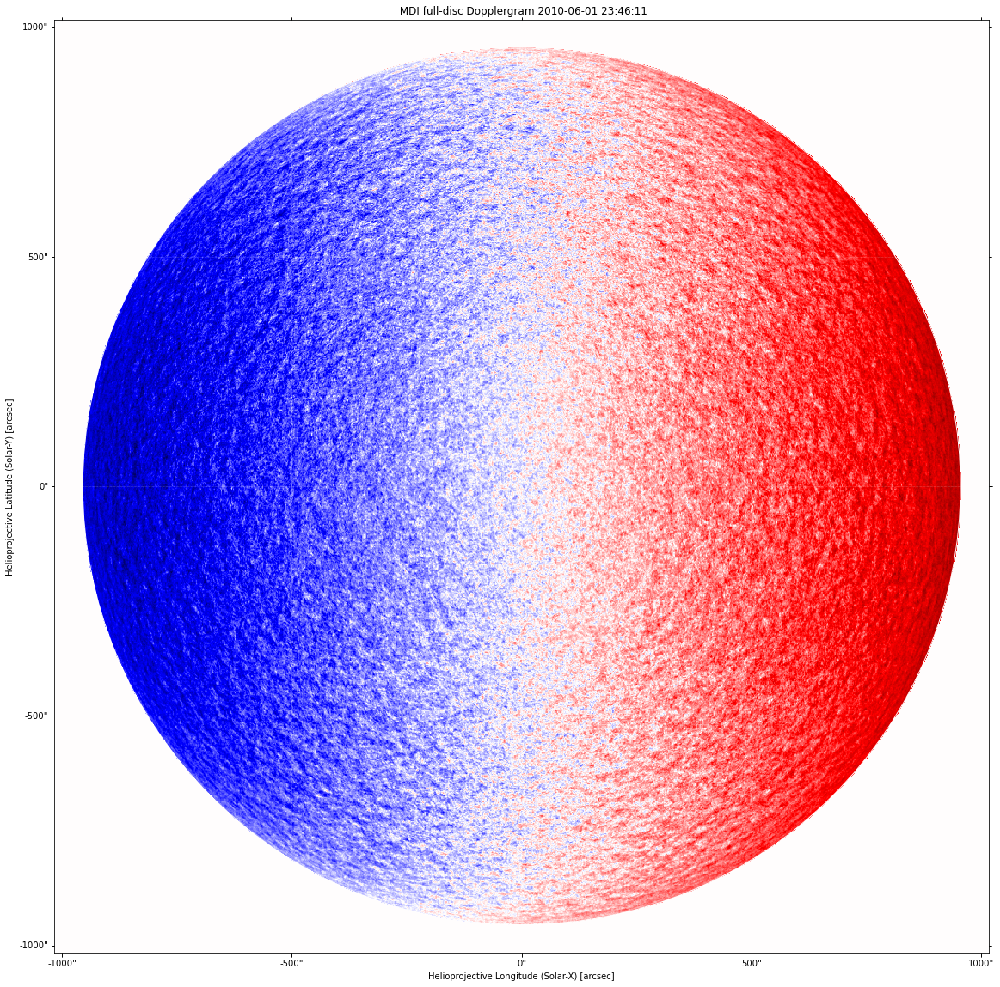

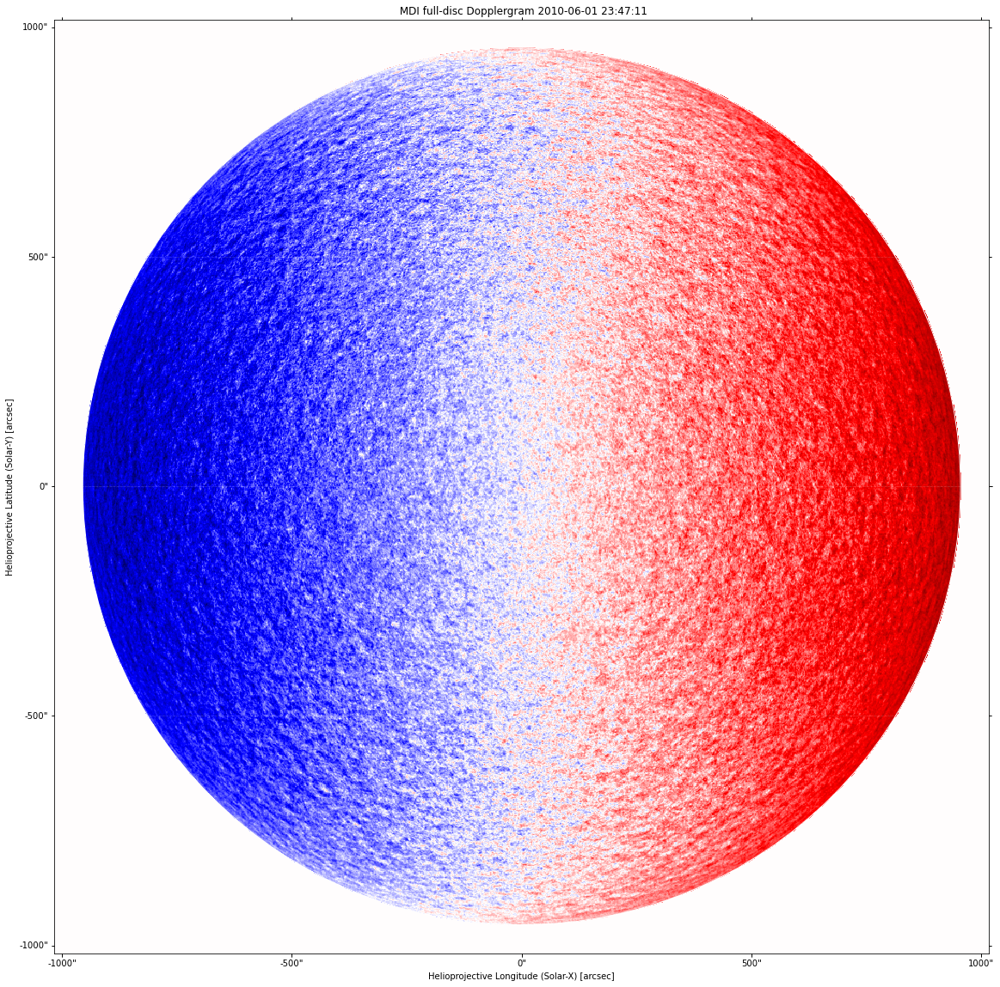

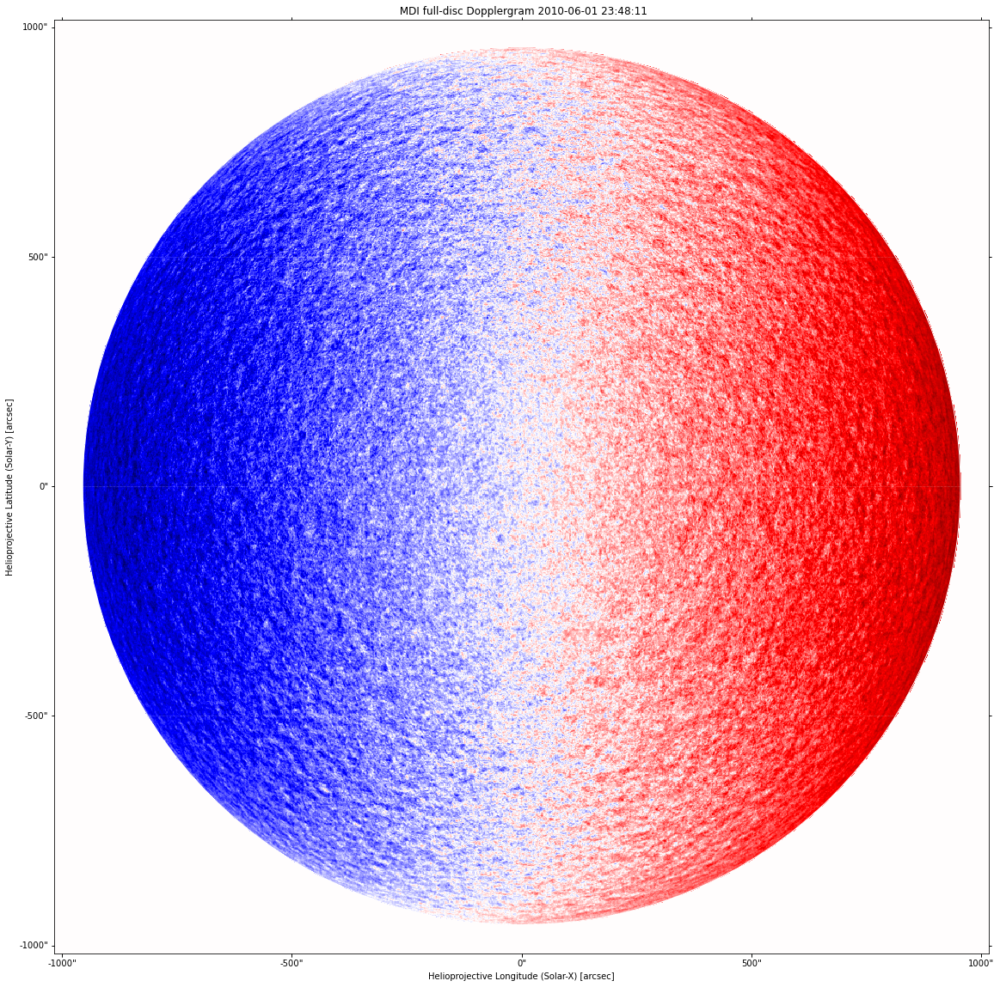

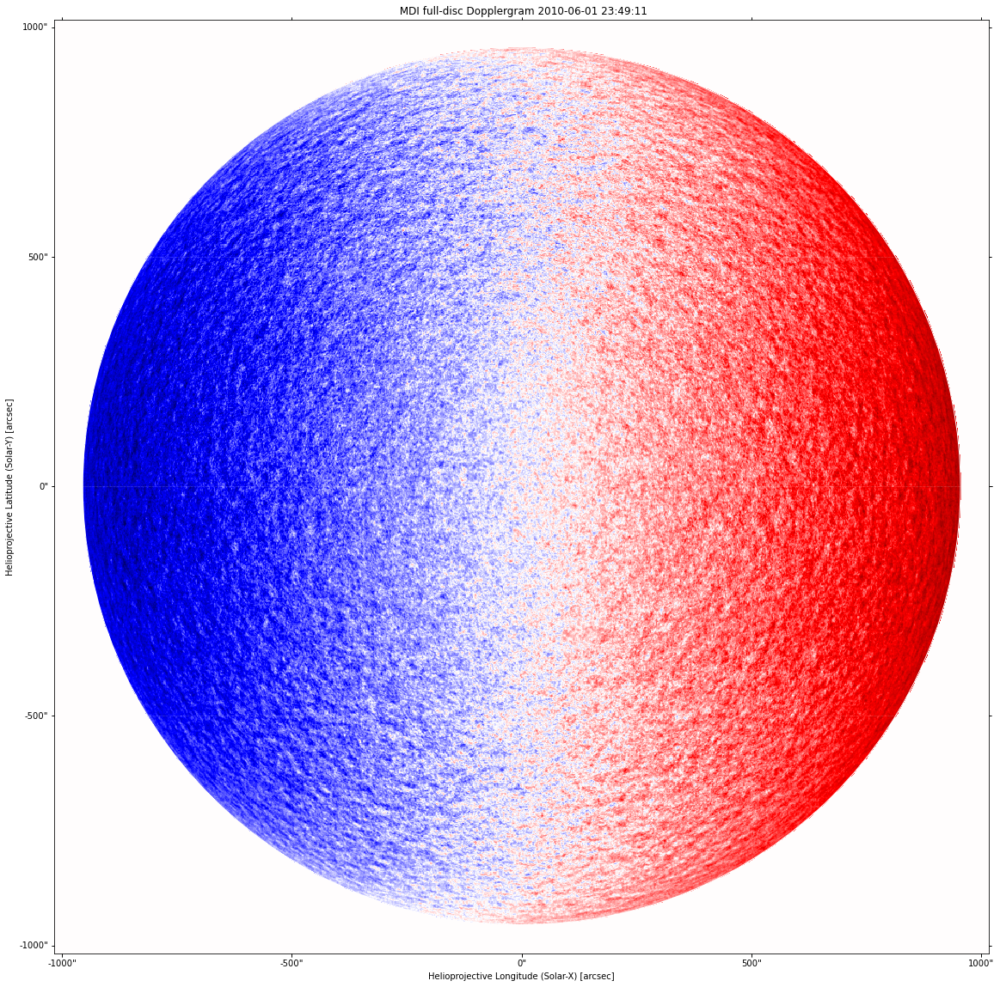

In [11]:
mdi_files = glob.glob(f'{data_folder}mdi/{year_s}/{str(month_s).zfill(2)}/*.fits')

mdi_fits_l = []
for i,file in enumerate(mdi_files):

    mdi_fits = fits.open(file, cache=False)
    mdi_fits.verify('fix')


    mdimapLR = Map(mdi_fits[1].data, mdi_fits[1].header)
    mdi_fits.close()  
    
    mdimapLR = mdimapLR.rotate(recenter=True)

    # # Crop image to desired shape
    sz_x_diff = (mdimapLR.data.shape[0]-1024)//2
    sz_y_diff = (mdimapLR.data.shape[0]-1024)//2

    mdimapLR.meta['crpix1'] = mdimapLR.meta['crpix1']-sz_x_diff
    mdimapLR.meta['crpix2'] = mdimapLR.meta['crpix2']-sz_y_diff
    
    mdimapLR = Map(mdimapLR.data[sz_x_diff:sz_x_diff+1024, sz_y_diff:sz_y_diff+1024].copy().astype(np.int32), mdimapLR.meta, dtype=np.int32)

    x, y = np.meshgrid(*[np.arange(v.value) for v in mdimapLR.dimensions]) * u.pixel
    hpc_coords = mdimapLR.pixel_to_world(x, y)
    rSun = np.sqrt(hpc_coords.Tx ** 2 + hpc_coords.Ty ** 2) / mdimapLR.rsun_obs
    mdimapLR.data[rSun>1] = 0
    
    plt.figure(figsize=(20,20))
    vlim = np.max(np.abs(mdimapLR.data))
    mdimapLR.plot(norm = mpl.colors.Normalize(vmin=-vlim, vmax=vlim), cmap=current_cmap)
    mdimapLR.draw_limb()    
    
#     plt.imshow(mdimapLR.data)
    mdi_fits_l.append(mdimapLR)

## Get ephemeris for solar information

In [12]:
solar_system_ephemeris.set('de432s')

<ScienceState solar_system_ephemeris: 'de432s'>

In [13]:
time = Time(f'{year_s}-{str(month_s).zfill(2)}-{str(day_s).zfill(2)} {str(hour_s).zfill(2)}:{str(minute_s).zfill(2)}:{str(second_s).zfill(2)}')
loc = EarthLocation.of_site('greenwich')
sun_loc = get_body('sun', time, loc)
rsun = (6.957e8*u.m).to(u.km)

sun_loc.distance.to(u.m).value

151708369549.95078

## Read GONG rotate and re-center

['D:/Mis Documentos/AAResearch/Codes/MDI to HMI doppler/Data/gong/2010/06\\mlvzi100601t2346.fits.gz', 'D:/Mis Documentos/AAResearch/Codes/MDI to HMI doppler/Data/gong/2010/06\\mlvzi100601t2347.fits.gz', 'D:/Mis Documentos/AAResearch/Codes/MDI to HMI doppler/Data/gong/2010/06\\mlvzi100601t2348.fits.gz', 'D:/Mis Documentos/AAResearch/Codes/MDI to HMI doppler/Data/gong/2010/06\\mlvzi100601t2349.fits.gz']
3.738137
2010-06-01T23:46:16.000


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,h

2.455813
2010-06-01T23:47:16.000


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,h

2.158562
2010-06-01T23:48:16.000


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,h

2.190174
2010-06-01T23:49:16.000


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,h

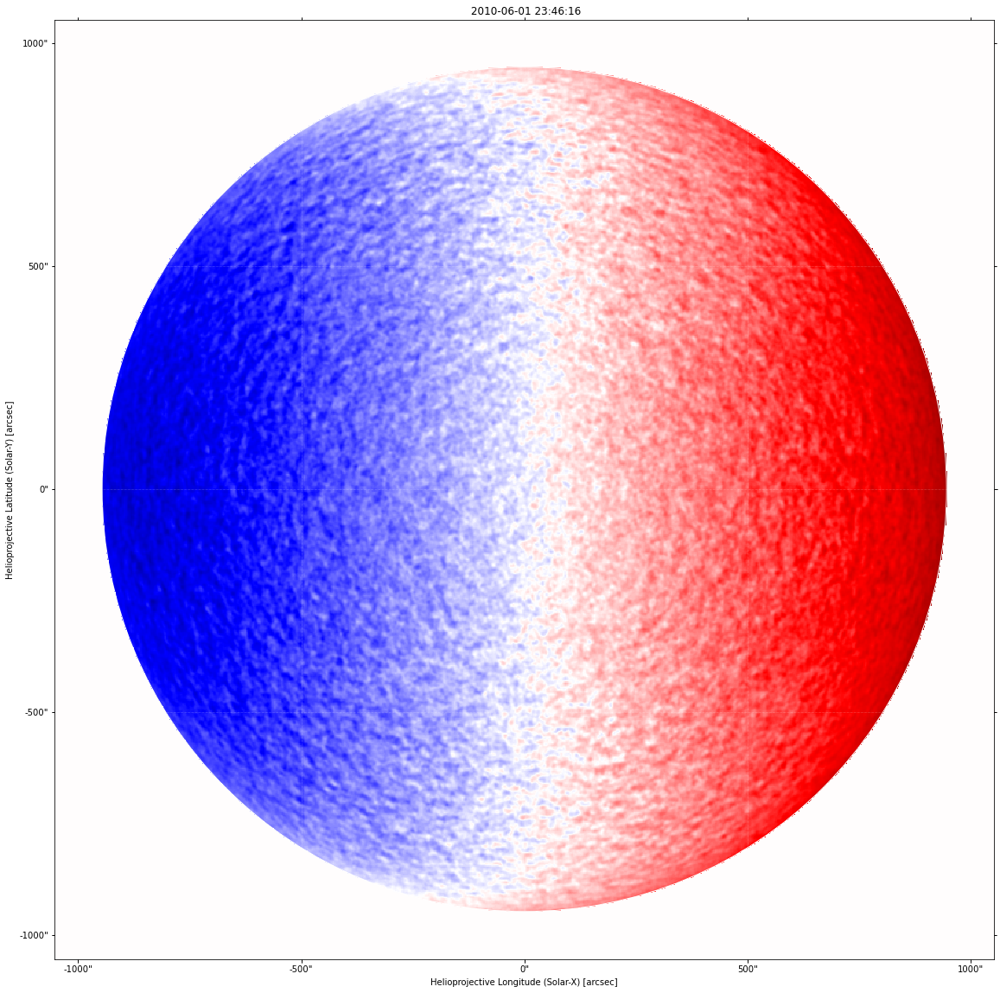

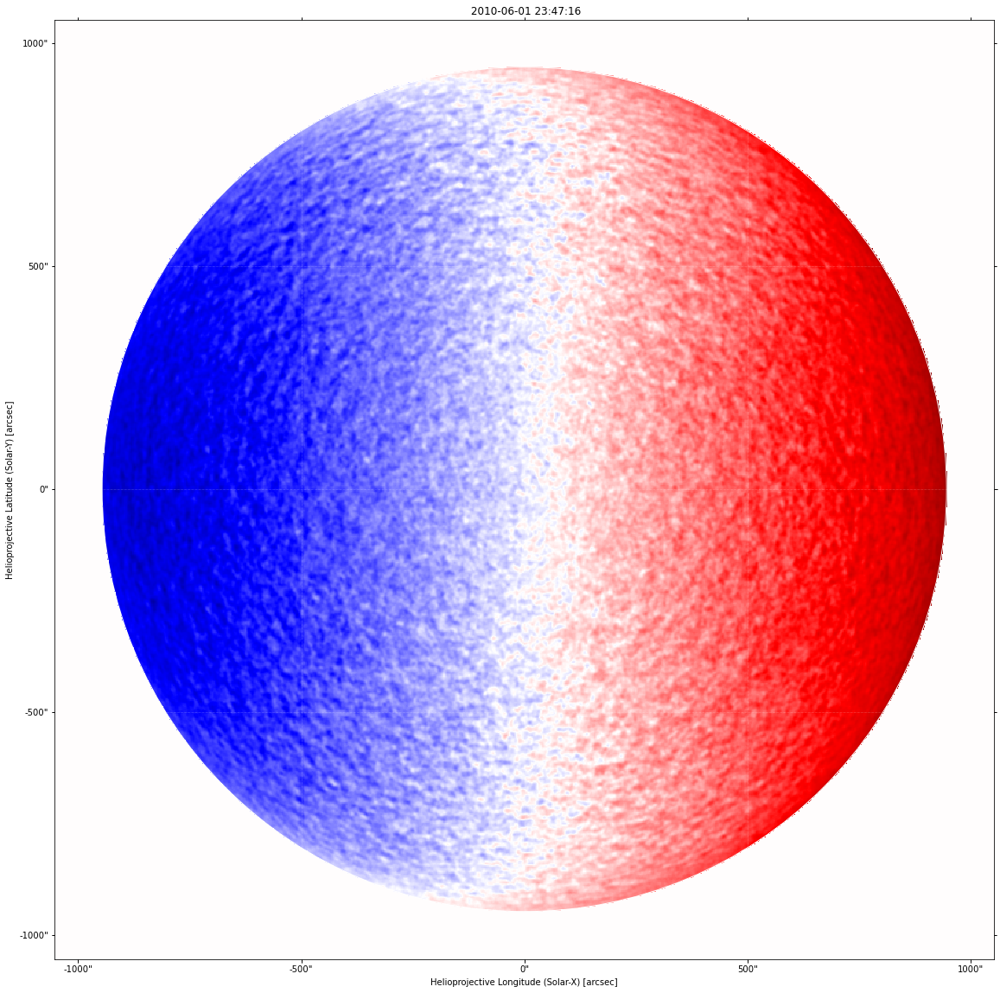

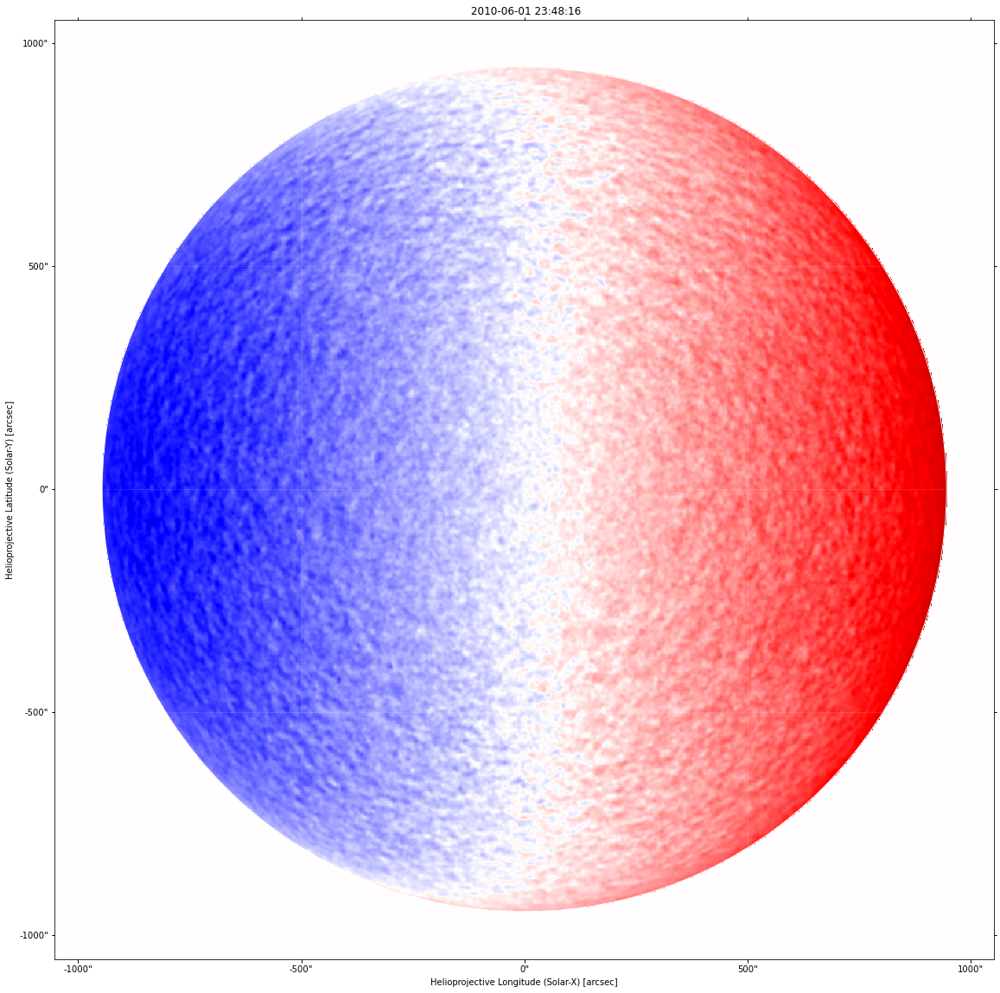

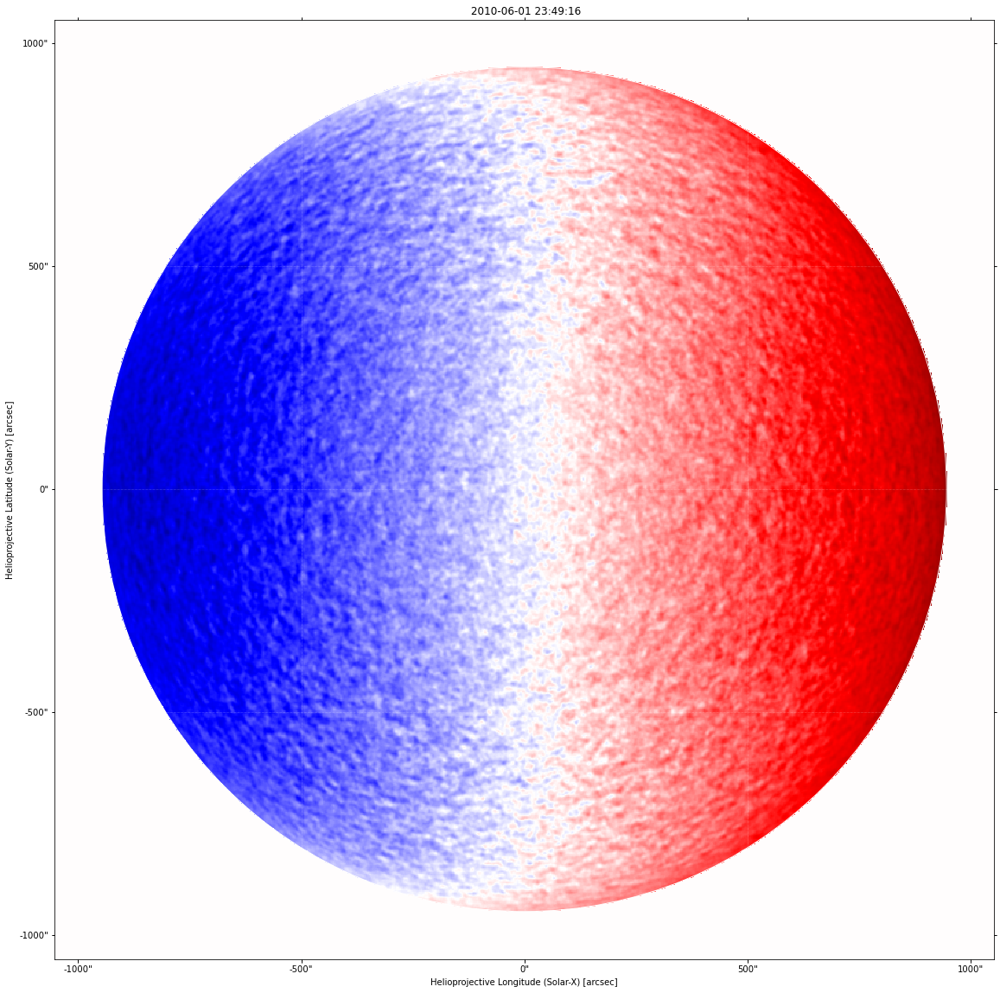

In [14]:
patchscale = 32

gong_files = glob.glob(f'{data_folder}gong/{year_s}/{str(month_s).zfill(2)}/*.fits.gz')

print(gong_files)

gong_fits_l = []
for i,file in enumerate(gong_files):

    gong_fits = fits.open(file, cache=False)
    gong_fits.verify('fix')
    
    ## Update header to make it useful    
    header = gong_fits[0].header
    header['RSUN_OBS'] = (header['RADIUS']*u.rad).to(u.arcsec).value  
    header['RSUN_REF'] = 696000000
    header['CROTA2'] = 0
    header['CUNIT1'] = 'arcsec'
    header['CUNIT2'] = 'arcsec'
#     header['DSUN_OBS'] = sun_loc.distance.to(u.m).value
    header['DSUN_REF'] = 149597870691
    header['DSUN_OBS'] = header['DSUN_REF']*header['DISTANCE']
    header['cdelt1'] = 2.5310 + 0.0005
    header['cdelt2'] = 2.5310 + 0.0005
#     header['cdelt1'] = header['FNDLMBAN']
#     header['cdelt2'] = header['FNDLMBAN']
    print(header['FNDLMBAN'])
#     header['crpix1'] = gong_fits[0].data.shape[0]//2 + 0.5
#     header['crpix2'] = gong_fits[0].data.shape[1]//2 + 0.5
    header['crpix1'] = header['FNDLMBXC'] + 0.5
    header['crpix2'] = header['FNDLMBYC'] + 0.5
    header['R_SUN'] = header['RSUN_OBS']/header['cdelt2']

    header['CTYPE1'] = 'HPLN-TAN'
    header['CTYPE2'] = 'HPLT-TAN'

    date = header['DATE-OBS']
    header['DATE-OBS'] = date[0:4] + '-' + date[5:7] + '-' + date[8:10] + 'T' + header['TIME-OBS'][0:11] + '0'    

    print(header['DATE-OBS'])
    
    
    ## Rotate
    gongmapLR = Map(gong_fits[0].data.T, header)
    gong_fits.close()  
    
    gongmapLR = gongmapLR.rotate(recenter=True)
    
    ## Calculate new shape to enable integer multiple of 32
    new_shape = int(gong_fits[0].data.shape[0]//patchscale)*patchscale
    shape_trim = int((gong_fits[0].data.shape[0]-new_shape)/2)  
    
    # # Crop image to desired shape
    sz_x_diff = (gongmapLR.data.shape[0]-gong_fits[0].data.shape[0])//2 + shape_trim
    sz_y_diff = (gongmapLR.data.shape[1]-gong_fits[0].data.shape[1])//2 + shape_trim

    gongmapLR.meta['crpix1'] = gongmapLR.meta['crpix1']-sz_x_diff
    gongmapLR.meta['crpix2'] = gongmapLR.meta['crpix2']-sz_y_diff
    
    gongmapLR = Map(gongmapLR.data[sz_x_diff:sz_x_diff+new_shape, sz_y_diff:sz_y_diff+new_shape].copy().astype(np.int32), gongmapLR.meta, dtype=np.int32)

    x, y = np.meshgrid(*[np.arange(v.value) for v in gongmapLR.dimensions]) * u.pixel
    hpc_coords = gongmapLR.pixel_to_world(x, y)
    rSun = np.sqrt(hpc_coords.Tx ** 2 + hpc_coords.Ty ** 2) / gongmapLR.rsun_obs
    gongmapLR.data[rSun>1] = 0
    
    plt.figure(figsize=(20,20))
    vlim = np.max(np.abs(gongmapLR.data))
    gongmapLR.plot(norm = mpl.colors.Normalize(vmin=-vlim, vmax=vlim), cmap=current_cmap)
    gongmapLR.draw_limb() 
#     plt.imshow(gongmapLR.data)
    
    gong_fits_l.append(gongmapLR)

## Read HMI rotate and re-center

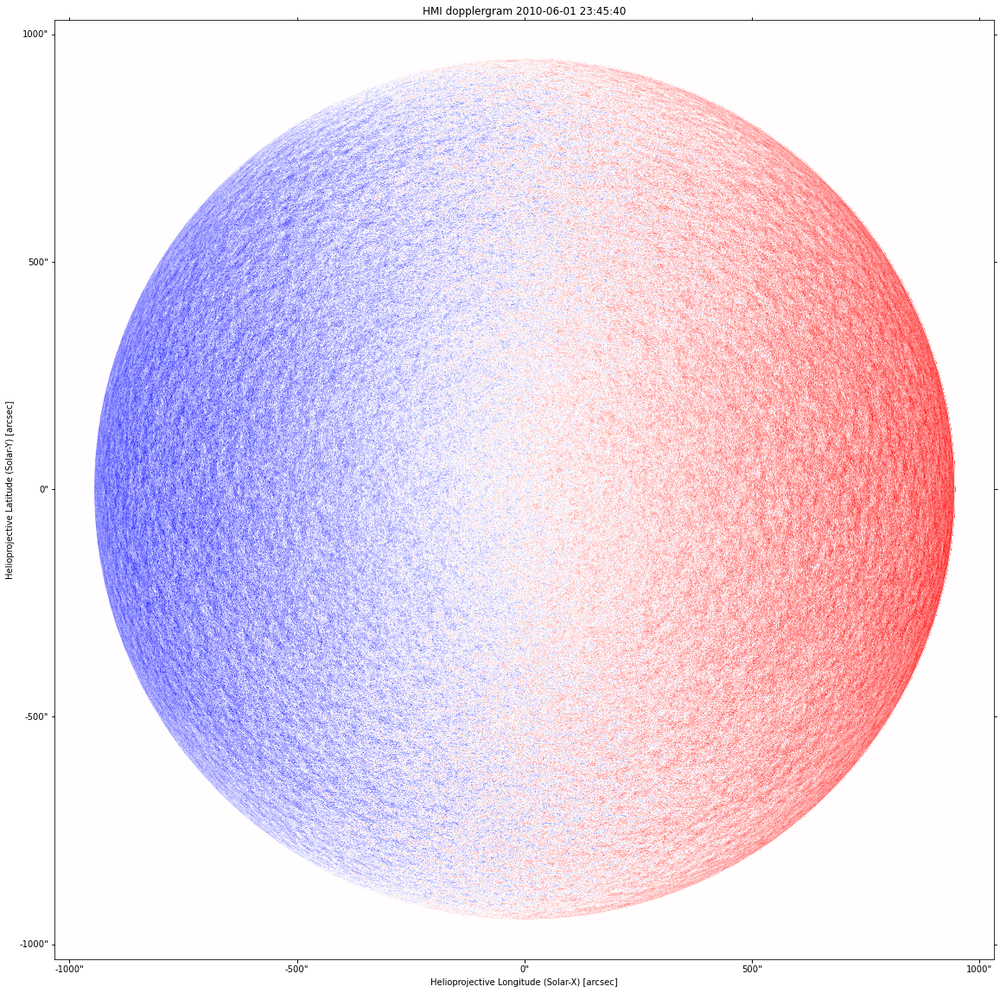

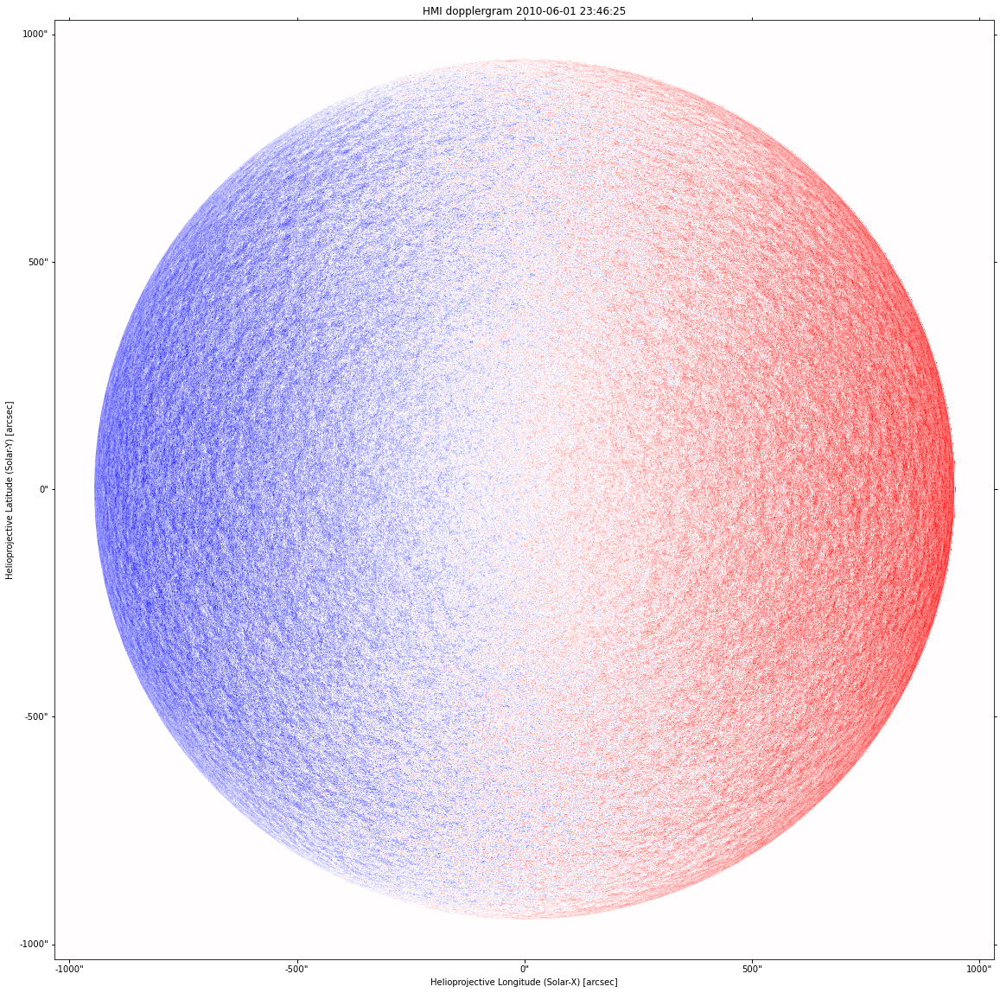

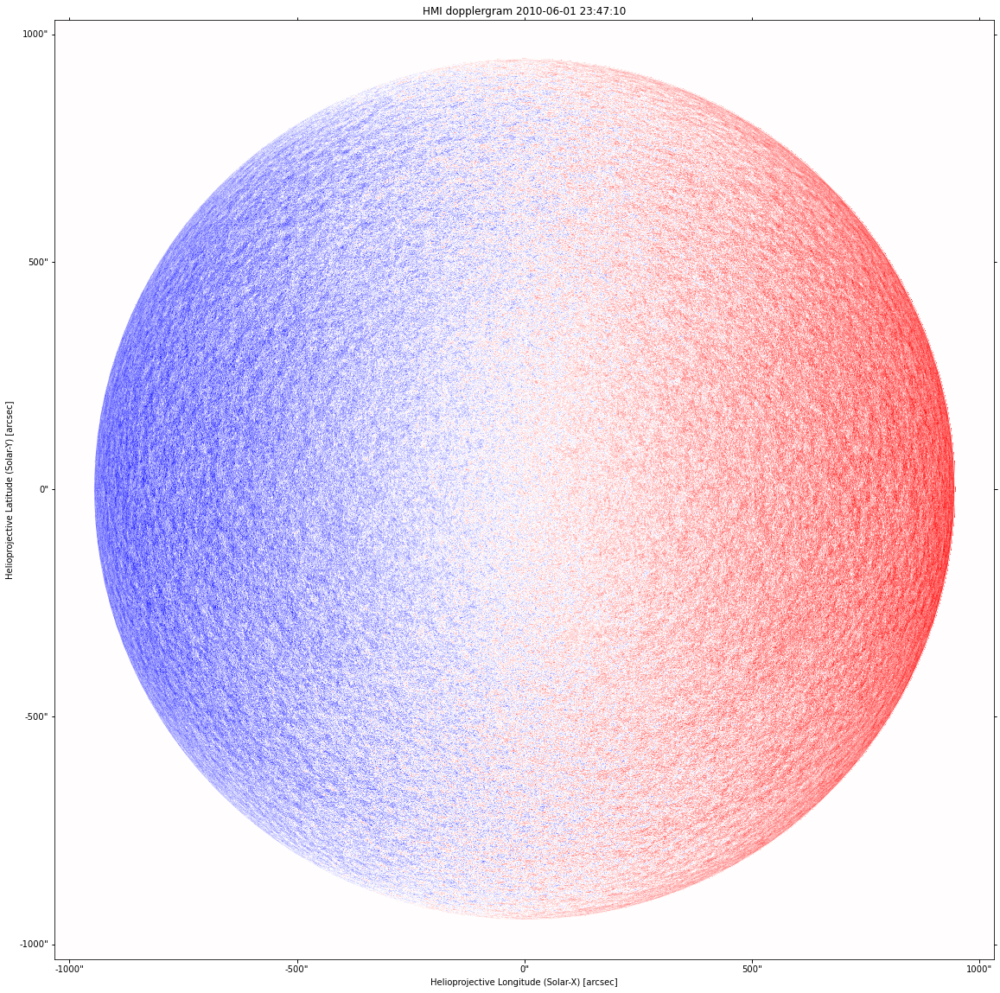

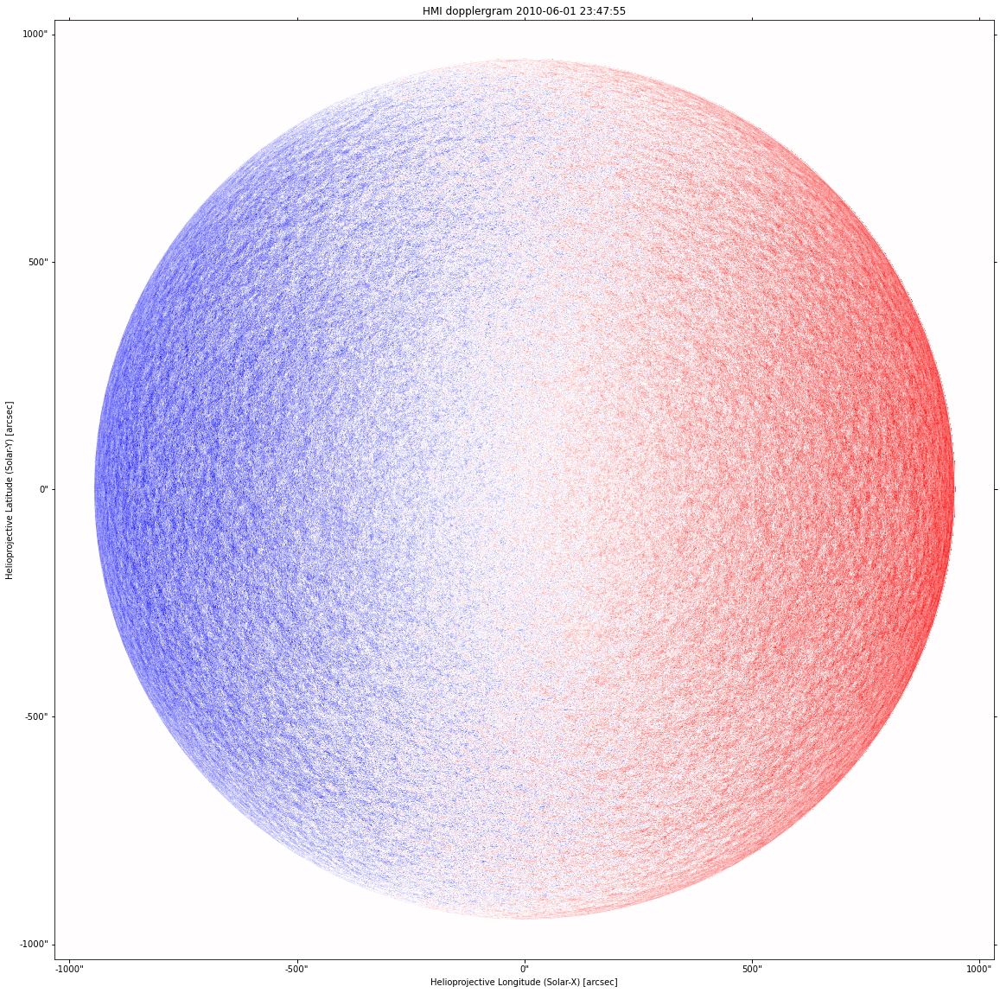

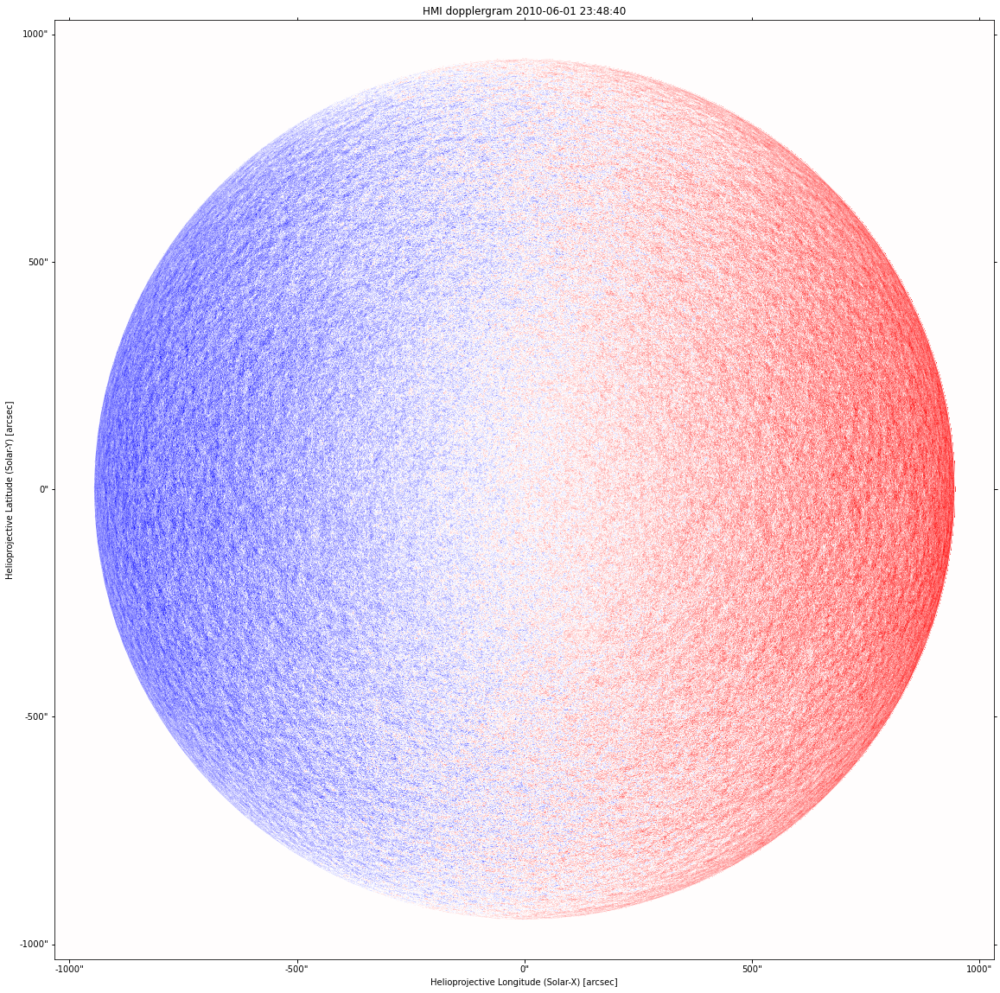

In [15]:
hmi_files = glob.glob(f'{data_folder}hmi/{year_s}/{str(month_s).zfill(2)}/*.fits')

hmi_fits_l = []
for i,file in enumerate(hmi_files):

    hmi_fits = fits.open(file, cache=False)
    hmi_fits.verify('fix')


    hmimap = Map(hmi_fits[1].data- hmi_fits[1].header['OBS_VR'], hmi_fits[1].header)
    hmi_fits.close()  
    
    hmimap = hmimap.rotate(recenter=True)

    # # Crop image to desired shape
    sz_x_diff = (hmimap.data.shape[0]-4096)//2
    sz_y_diff = (hmimap.data.shape[0]-4096)//2

    hmimap.meta['crpix1'] = hmimap.meta['crpix1']-sz_x_diff
    hmimap.meta['crpix2'] = hmimap.meta['crpix2']-sz_y_diff
    
    hmimap = Map((hmimap.data[sz_x_diff:sz_x_diff+4096, sz_y_diff:sz_y_diff+4096].copy()).astype(np.int32), hmimap.meta, dtype=np.int32)

    x, y = np.meshgrid(*[np.arange(v.value) for v in hmimap.dimensions]) * u.pixel
    hpc_coords = hmimap.pixel_to_world(x, y)
    rSun = np.sqrt(hpc_coords.Tx ** 2 + hpc_coords.Ty ** 2) / hmimap.rsun_obs
    hmimap.data[rSun>1] = 0
    
#     plt.imshow(hmimap.data)

    plt.figure(figsize=(20,20))
    vlim = np.max(np.abs(hmimap.data))
    hmimap.plot(norm = mpl.colors.Normalize(vmin=-vlim, vmax=vlim), cmap=current_cmap)
    hmimap.draw_limb()

    hmi_fits_l.append(hmimap)

In [16]:
hmi_fits[1].header

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                  -32 / data type of original image                    
NAXIS   =                    2 / dimension of original image                    
NAXIS1  =                 4096 / length of original image axis                  
NAXIS2  =                 4096 / length of original image axis                  
PCOUNT  =                    0 / size of special data area                      
GCOUNT  =                    1 / one data group (required keyword)              
XTENSION= 'BINTABLE'           / binary table extension                         
BLANK   =               -32768                                                  
CHECKSUM= 'Z56Eh249Z24Ef249'   / HDU checksum updated 2021-10-01T23:35:49       
DATE    = '2012-09-05T09:23:09.000' / [ISO] HDU creation date                   
DATE-OBS= '2010-06-01T23:48:40.500' / [ISO] Observation date {DATE__OBS}        
TELESCOP= 'SDO/HMI '        

## Upscale MDI

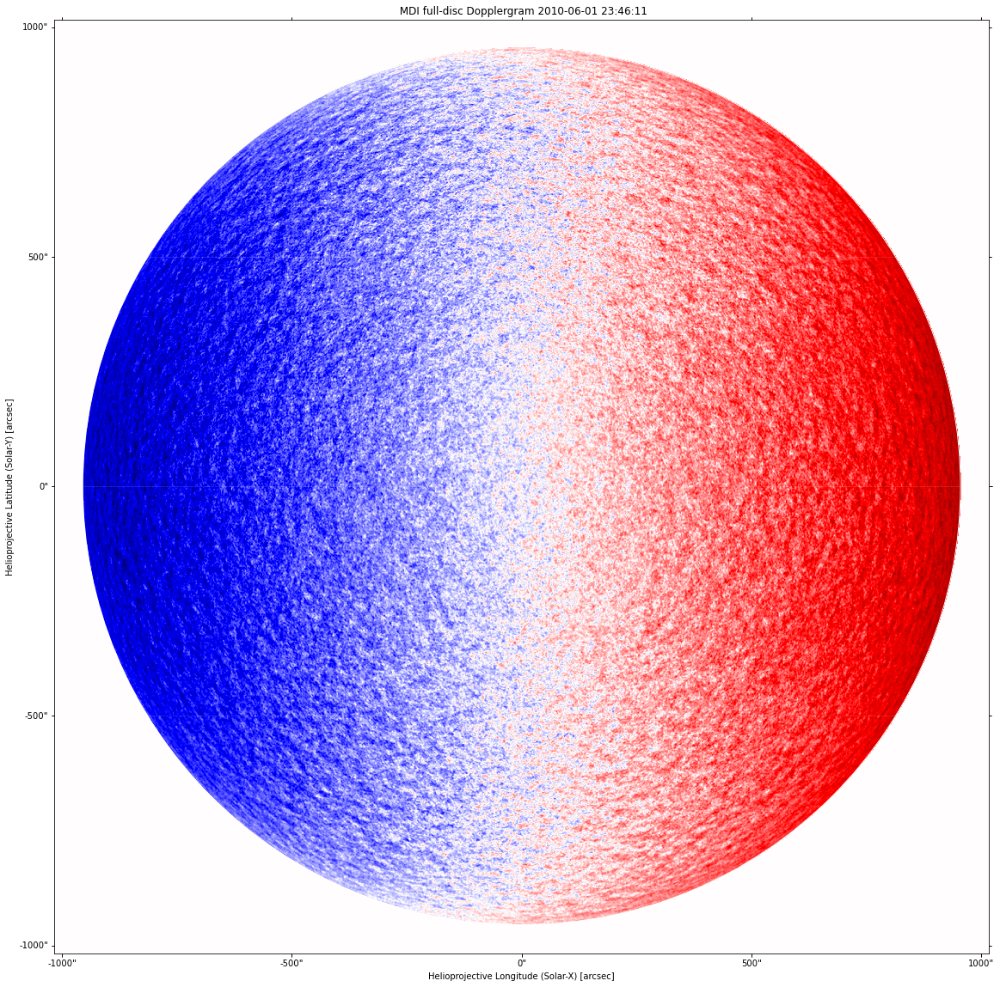

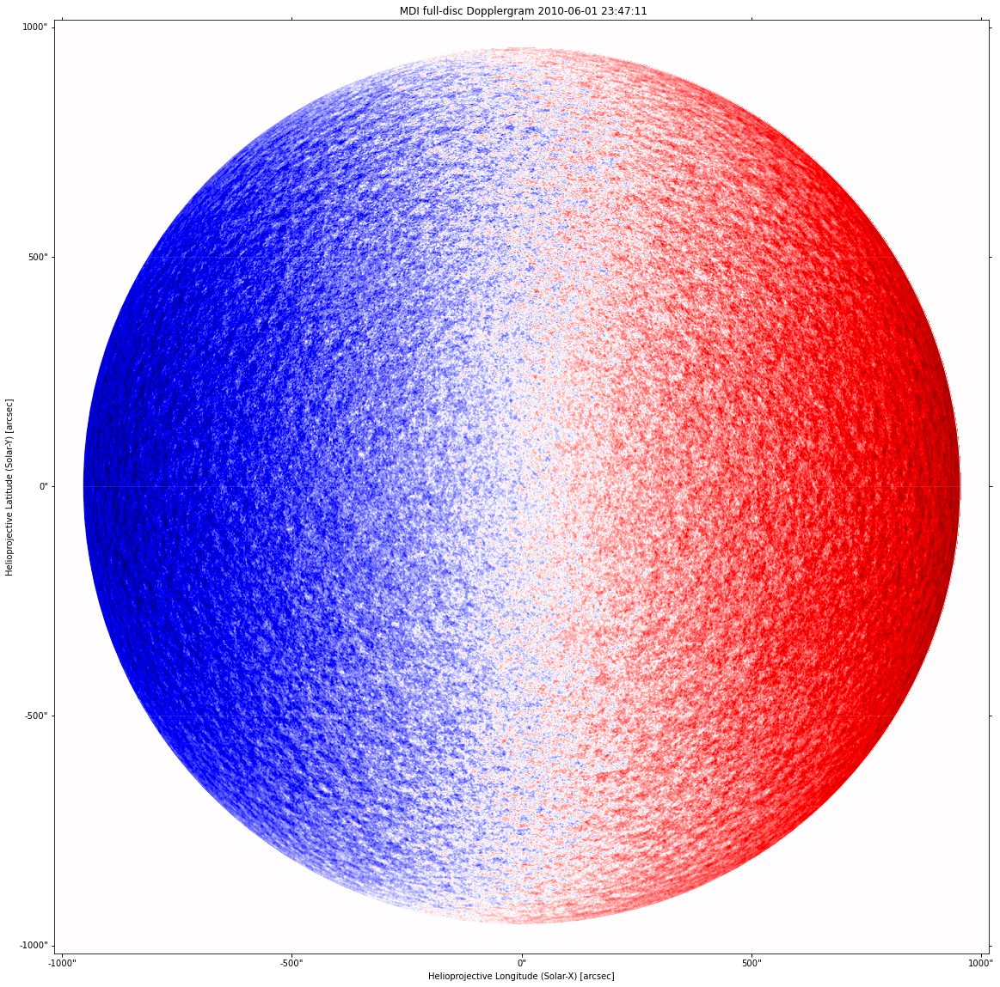

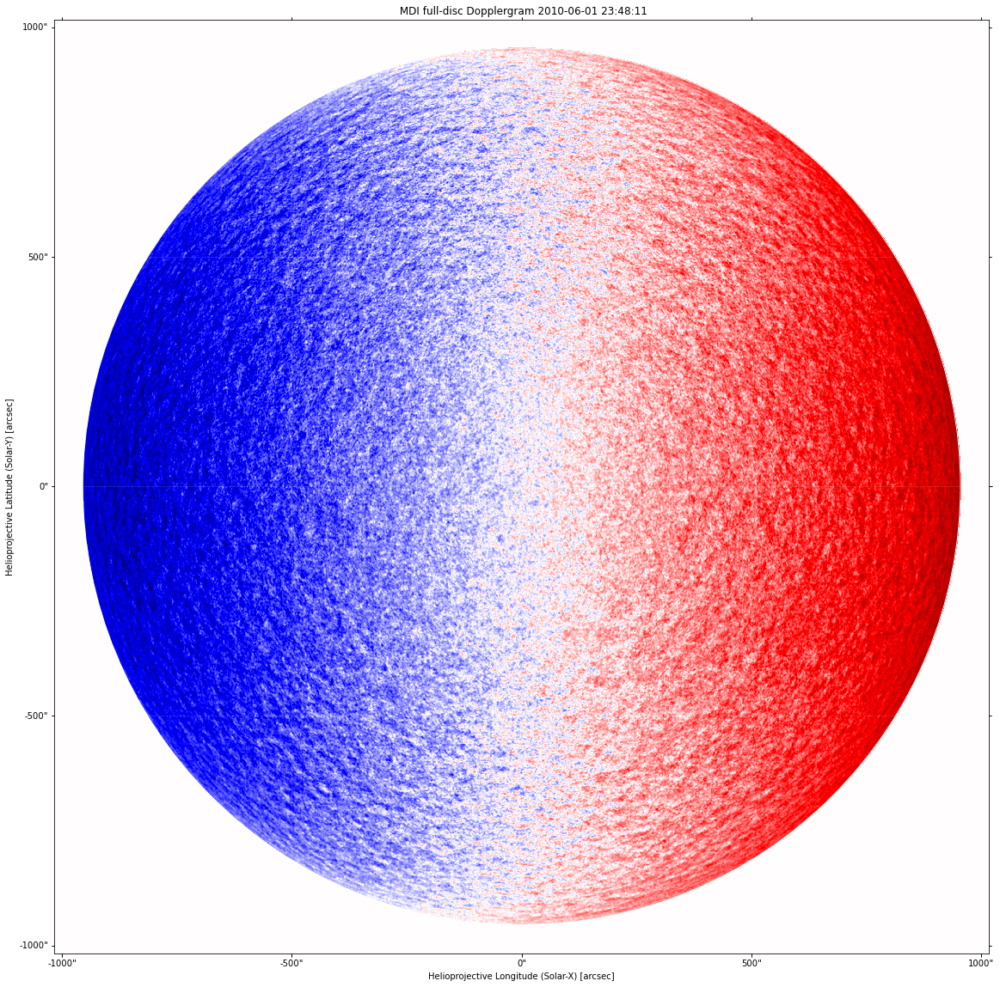

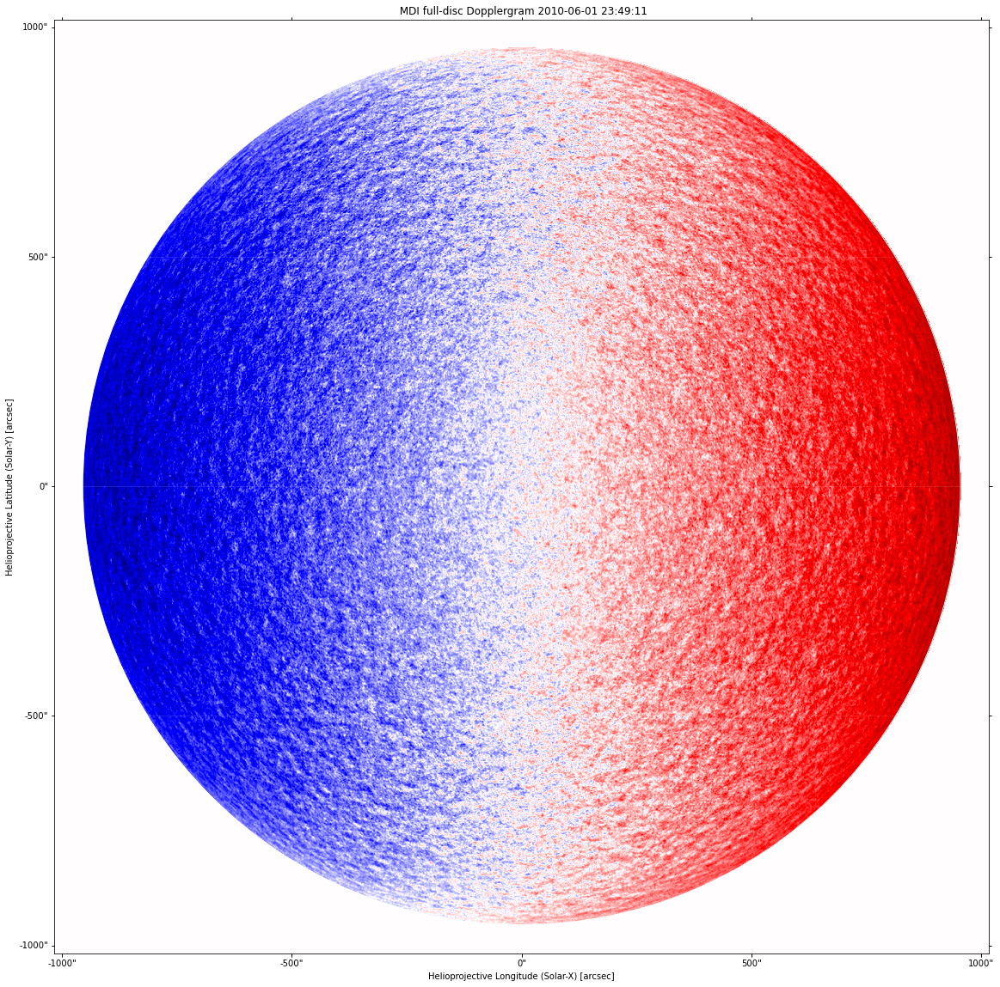

In [17]:
scale_factor = 4

mdi_fits_hr_l = []
for i,dmap in enumerate(mdi_fits_l):

    new_meta = dmap.meta.copy()

    # Changing scale and center
    new_meta['crpix1'] = (new_meta['crpix1'] - dmap.data.shape[0] / 2 - 0.5) * scale_factor + dmap.data.shape[0] * scale_factor / 2 + 0.5
    new_meta['crpix2'] = (new_meta['crpix2'] - dmap.data.shape[1] / 2 - 0.5) * scale_factor + dmap.data.shape[1] * scale_factor / 2 + 0.5

#     new_meta['cdelt1'] = new_meta['cdelt1'] / scale_factor
#     new_meta['cdelt2'] = new_meta['cdelt2'] / scale_factor
    new_meta['r_sun'] = new_meta['r_sun'] * scale_factor    

    # Pad image, if necessary
    target_shape = int(dmap.data.shape[0]*scale_factor)

    # Reform map to new size if original shape is too small


    new_fov = np.zeros((target_shape, target_shape)) * np.nan
    # Identify the indices for appending the map original FoV
    i1 = int(new_fov.shape[0] / 2 - dmap.data.shape[0] / 2)
    i2 = int(new_fov.shape[0] / 2 + dmap.data.shape[0] / 2)

    # Insert original image in new field of view
    new_fov[i1:i2, i1:i2] = dmap.data[:, :]

    # Assemble Sunpy map
    MDImap = Map(new_fov, new_meta)
    MDImap = MDImap.rotate(scale=scale_factor, recenter=True)


    # # Crop image to desired shape
    sz_x_diff = (MDImap.data.shape[0]-target_shape)//2
    sz_y_diff = (MDImap.data.shape[0]-target_shape)//2

    MDImap.meta['crpix1'] = MDImap.meta['crpix1']-sz_x_diff
    MDImap.meta['crpix2'] = MDImap.meta['crpix2']-sz_y_diff

    MDImap = Map(MDImap.data[sz_x_diff:sz_x_diff+target_shape, sz_y_diff:sz_y_diff+target_shape].copy(), MDImap.meta)

    x, y = np.meshgrid(*[np.arange(v.value) for v in MDImap.dimensions]) * u.pixel
    hpc_coords = MDImap.pixel_to_world(x, y)
    rSun = np.sqrt(hpc_coords.Tx ** 2 + hpc_coords.Ty ** 2) / MDImap.rsun_obs
    MDImap.data[rSun>1] = 0
    
    plt.figure(figsize=(20,20))
    vlim = np.max(np.abs(MDImap.data))
    MDImap.plot(norm = mpl.colors.Normalize(vmin=-vlim, vmax=vlim), cmap=current_cmap)
    MDImap.draw_limb()     
    
    mdi_fits_hr_l.append(MDImap)

## Upscale GONG

416.5 416.5
1664.5 1664.5


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)


1664.5 1664.5


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)


416.5 416.5
1664.5 1664.5


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)


1664.5 1664.5


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)


416.5 416.5
1664.5 1664.5


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)


1664.5 1664.5


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)


416.5 416.5
1664.5 1664.5


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)
C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)


1664.5 1664.5


C:\Users\Andres\anaconda3\envs\sunpy\lib\site-packages\sunpy\util\decorators.py:378: SunpyMetadataWarning: Missing metadata for observer: assuming Earth-based observer.
For frame 'heliographic_stonyhurst' the following metadata is missing: hgln_obs,hglt_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs

  new_val = prop(instance)


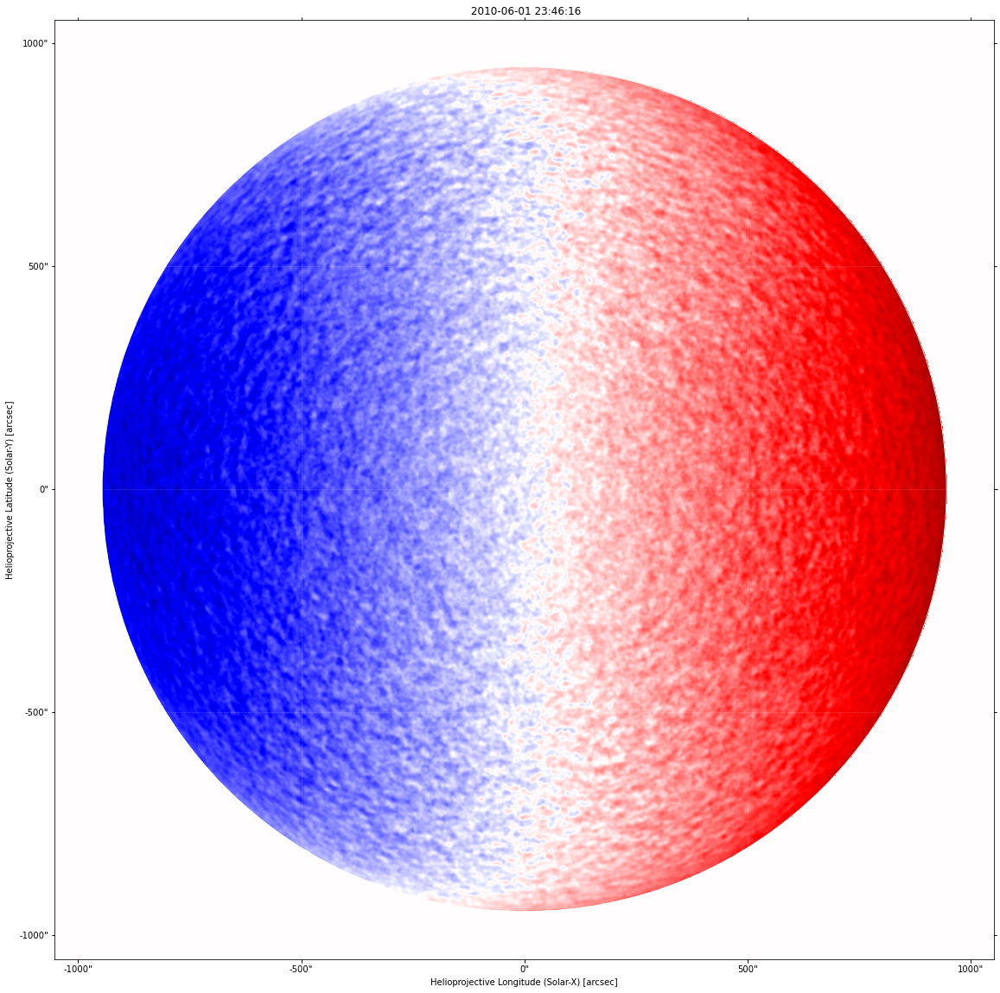

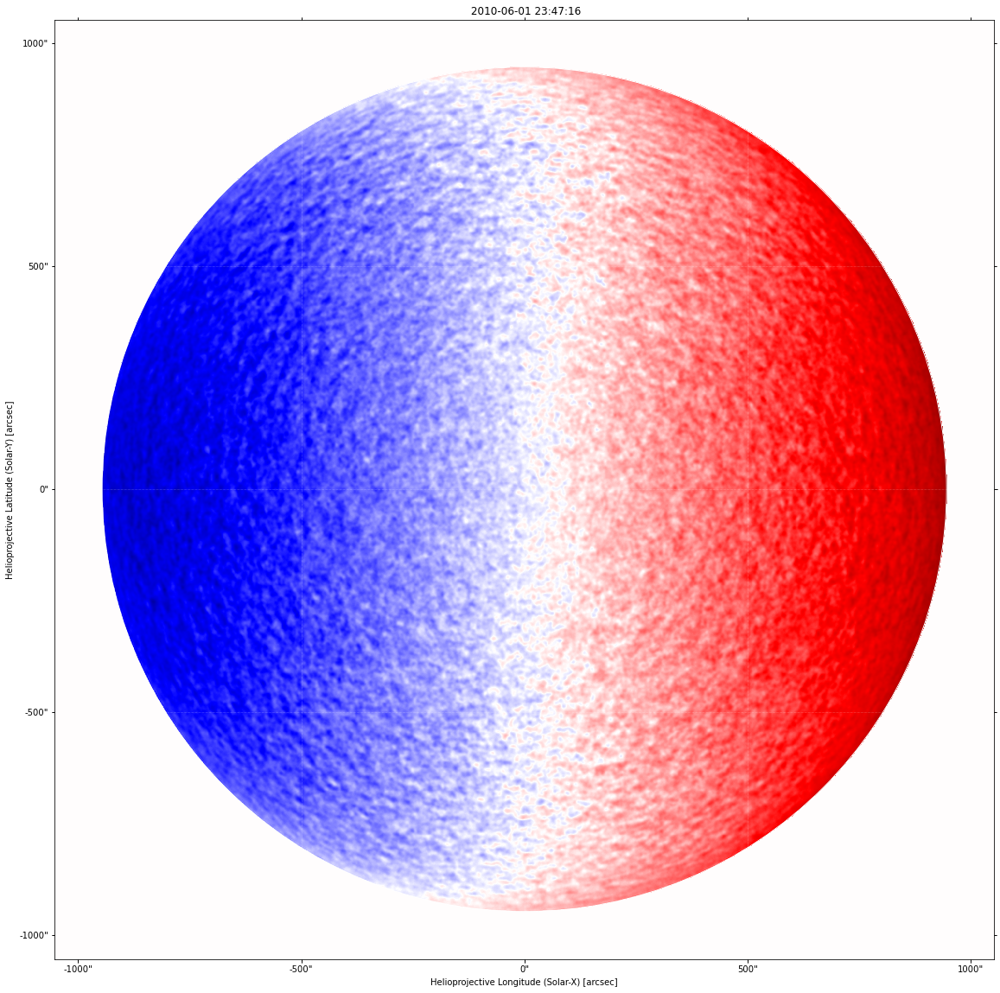

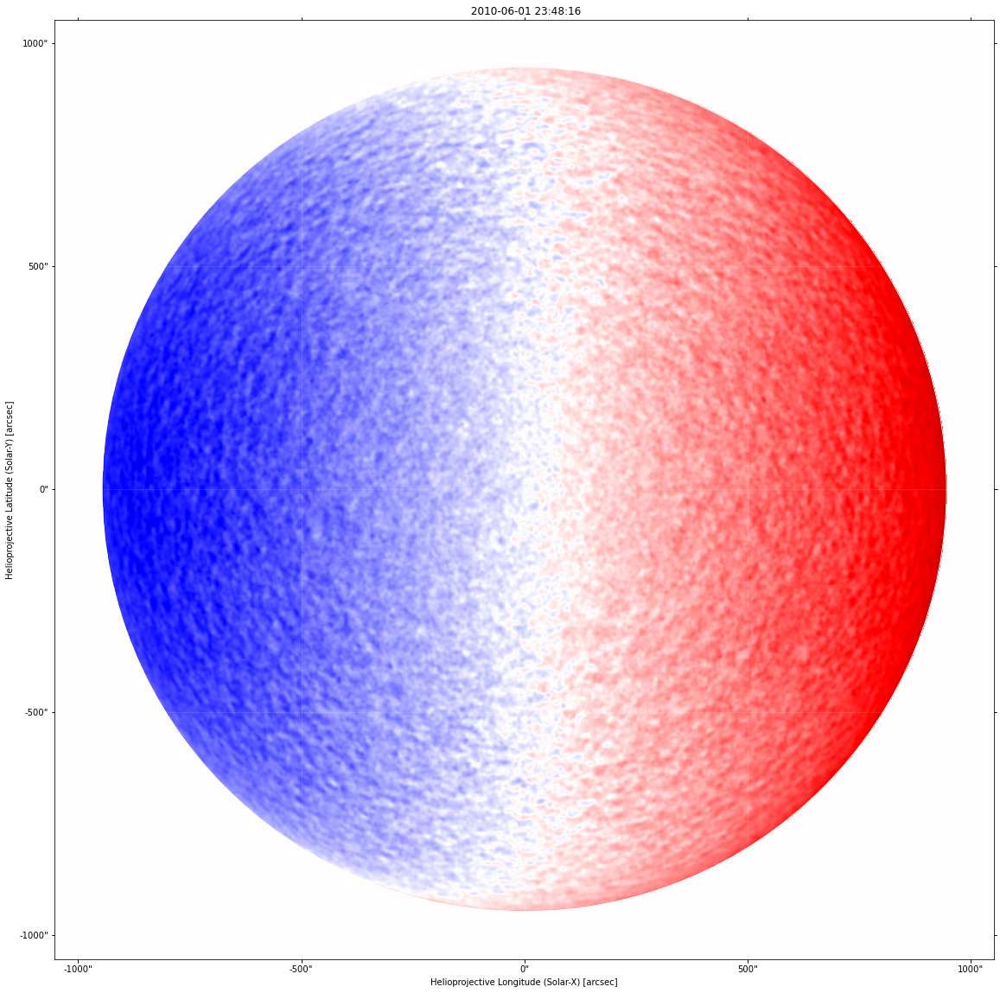

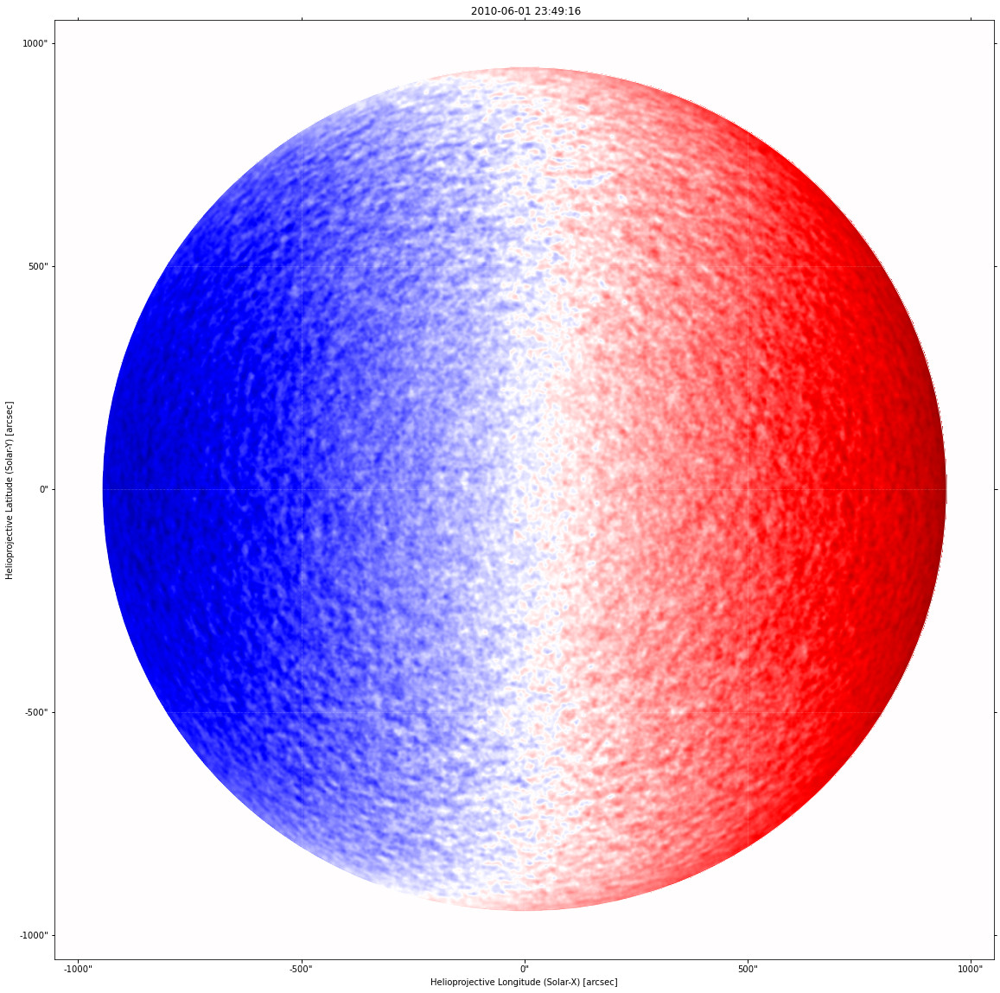

In [18]:
gong_fits_hr_l = []
for i,dmap in enumerate(gong_fits_l):

    new_meta = dmap.meta.copy()

    print(new_meta['crpix1'], new_meta['crpix2'])
    
    # Changing scale and center
    new_meta['crpix1'] = (new_meta['crpix1'] - dmap.data.shape[0] / 2 - 0.5) * scale_factor + dmap.data.shape[0] * scale_factor / 2 + 0.5
    new_meta['crpix2'] = (new_meta['crpix2'] - dmap.data.shape[1] / 2 - 0.5) * scale_factor + dmap.data.shape[1] * scale_factor / 2 + 0.5

    print(new_meta['crpix1'], new_meta['crpix2'])
    
    
#     new_meta['cdelt1'] = new_meta['cdelt1'] / scale_factor
#     new_meta['cdelt2'] = new_meta['cdelt2'] / scale_factor
    new_meta['r_sun'] = new_meta['r_sun'] * scale_factor    

    # Pad image, if necessary
    target_shape = int(dmap.data.shape[0]*scale_factor)

    # Reform map to new size if original shape is too small


    new_fov = np.zeros((target_shape, target_shape)) * np.nan
    # Identify the indices for appending the map original FoV
    i1 = int(new_fov.shape[0] / 2 - dmap.data.shape[0] / 2)
    i2 = int(new_fov.shape[0] / 2 + dmap.data.shape[0] / 2)

    # Insert original image in new field of view
    new_fov[i1:i2, i1:i2] = dmap.data[:, :]

    # Assemble Sunpy map
    gongmap = Map(new_fov, new_meta)
    gongmap = gongmap.rotate(scale=scale_factor, recenter=True)


    # # Crop image to desired shape
    sz_x_diff = (gongmap.data.shape[0]-target_shape)//2
    sz_y_diff = (gongmap.data.shape[0]-target_shape)//2

    gongmap.meta['crpix1'] = gongmap.meta['crpix1']-sz_x_diff
    gongmap.meta['crpix2'] = gongmap.meta['crpix2']-sz_y_diff
    
    print(gongmap.meta['crpix1'], gongmap.meta['crpix2'])
    

    gongmap = Map(gongmap.data[sz_x_diff:sz_x_diff+target_shape, sz_y_diff:sz_y_diff+target_shape].copy(), gongmap.meta)

    x, y = np.meshgrid(*[np.arange(v.value) for v in gongmap.dimensions]) * u.pixel
    hpc_coords = gongmap.pixel_to_world(x, y)
    rSun = np.sqrt(hpc_coords.Tx ** 2 + hpc_coords.Ty ** 2) / gongmap.rsun_obs
    gongmap.data[rSun>1] = 0
    
    
    plt.figure(figsize=(20,20))
    vlim = np.max(np.abs(gongmap.data))
    gongmap.plot(norm = mpl.colors.Normalize(vmin=-vlim, vmax=vlim), cmap=current_cmap)
    gongmap.draw_limb()     
    
    gong_fits_hr_l.append(gongmap)

In [19]:
plt.close('all')

## Reproject `hmi_map` to `mdi_map` and create smoothed version

0it [00:00, ?it/s]

2010-06-01T23:45:40.500 0 2010-06-01 23:46:11


1it [00:41, 42.00s/it]

2010-06-01T23:46:25.500 0 2010-06-01 23:46:11


2it [01:22, 41.36s/it]

2010-06-01T23:47:10.500 1 2010-06-01 23:47:11


3it [02:05, 41.94s/it]

2010-06-01T23:47:55.500 2 2010-06-01 23:48:11


4it [02:46, 41.54s/it]

2010-06-01T23:48:40.500 2 2010-06-01 23:48:11


5it [03:27, 41.49s/it]


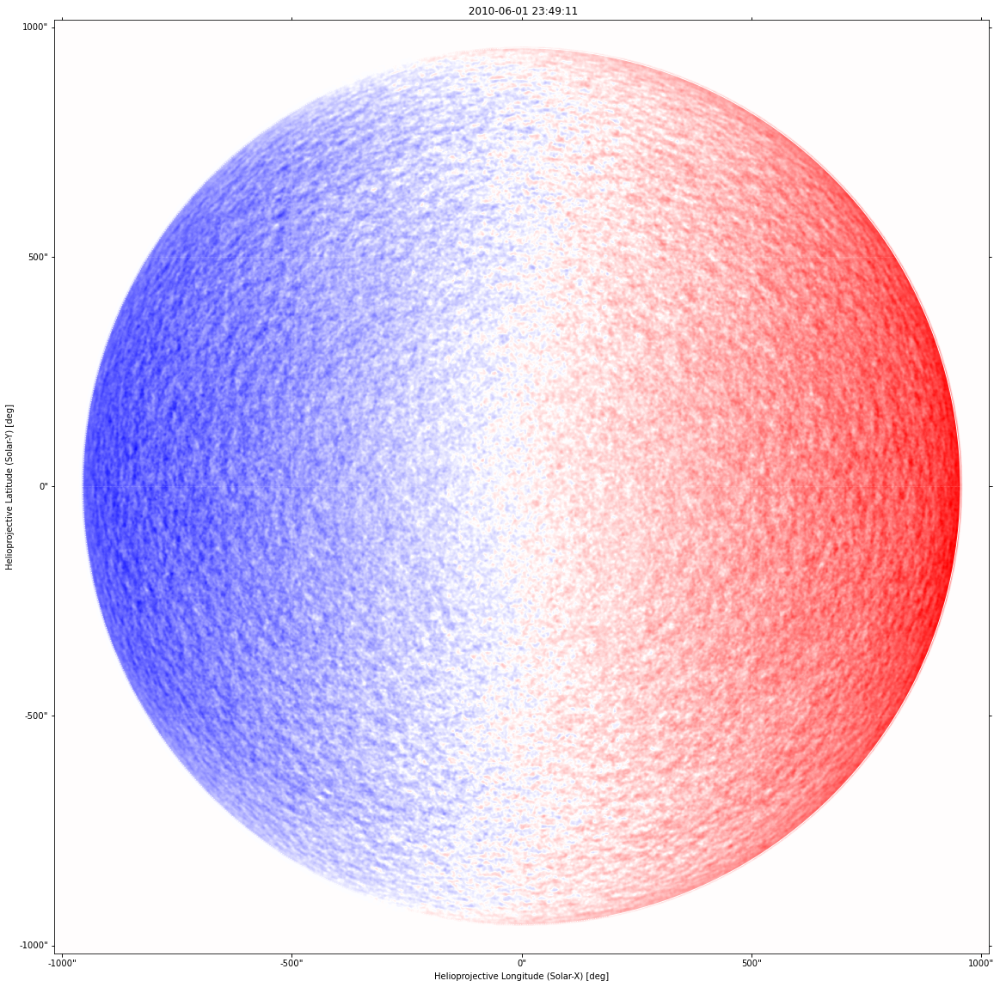

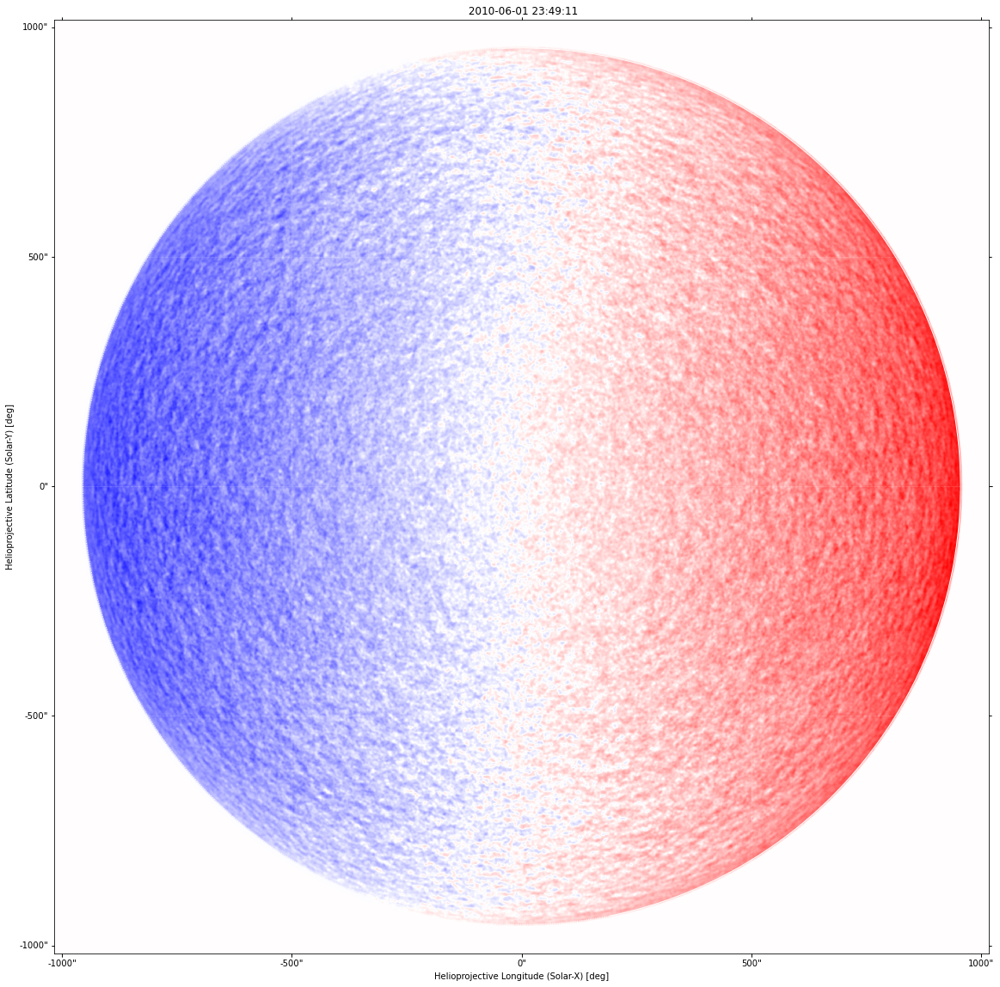

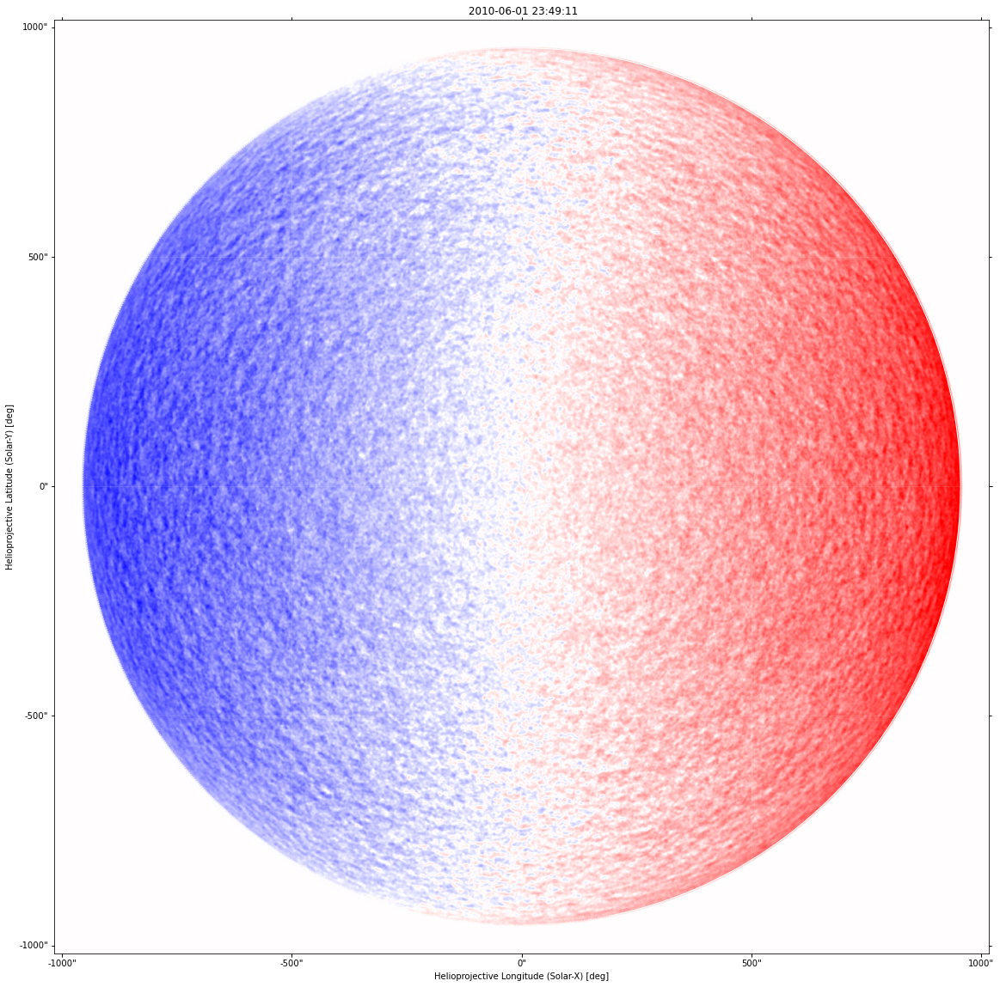

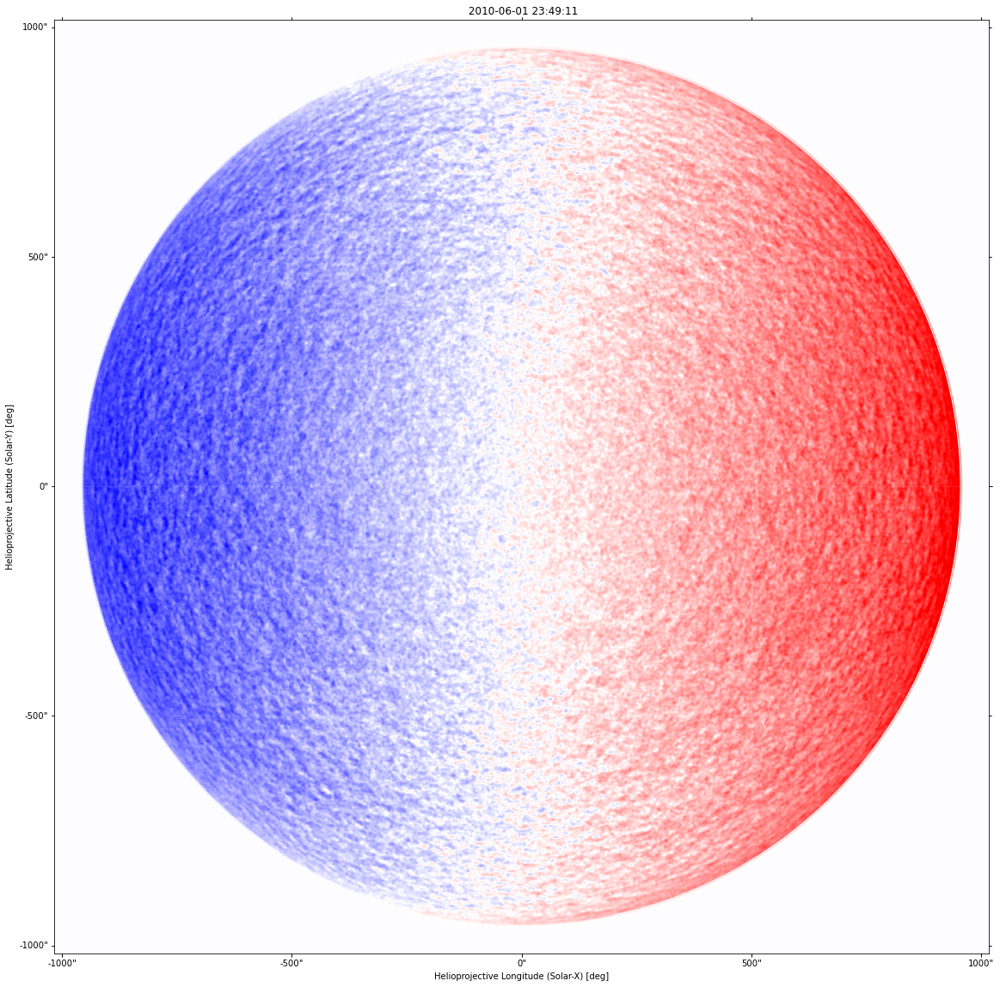

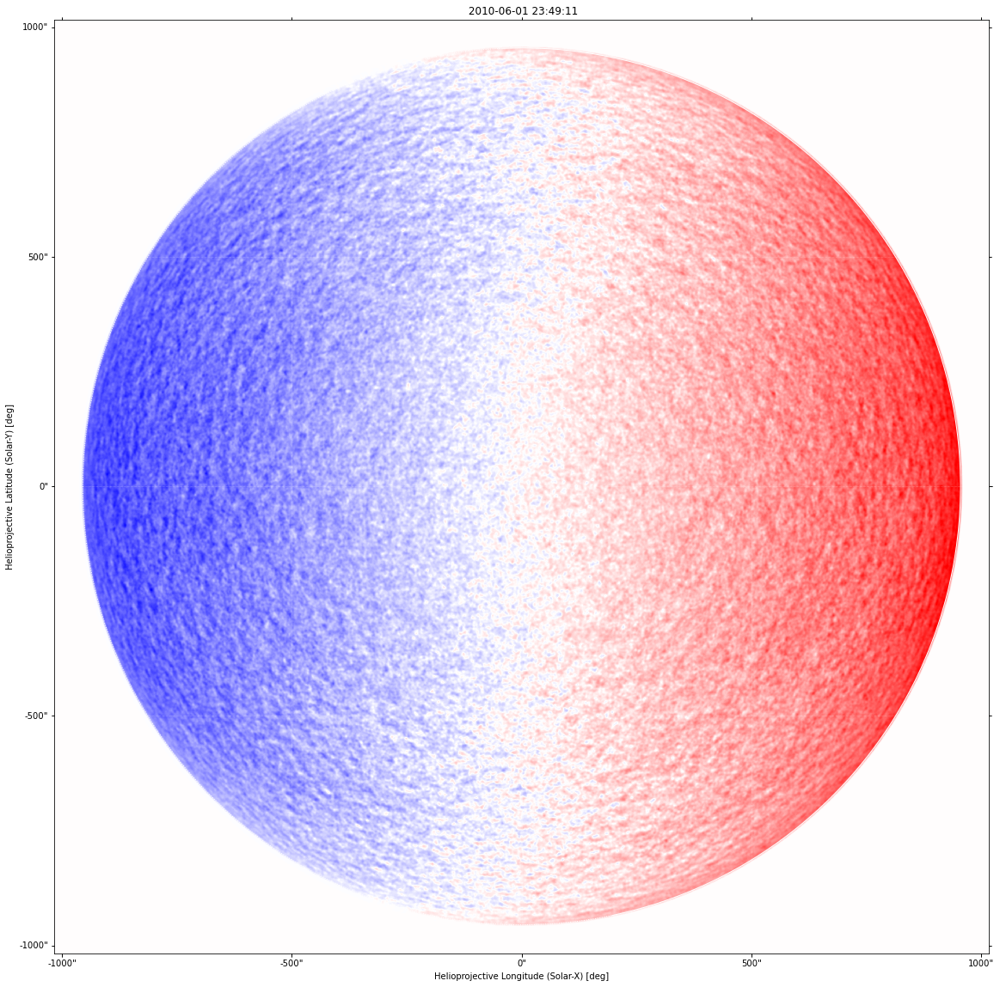

In [20]:
mdi_dates = np.array([datetime.fromisoformat(dmap.meta['date-obs']) for dmap in mdi_fits_hr_l])

hmi_mdi_fits_rp_l = []
hmi_mdi_fits_rps_l = []
for i,dmap in tqdm(enumerate(hmi_fits_l)):
    inx = np.argmin([np.abs(delta.total_seconds()) for delta in datetime.fromisoformat(dmap.meta['date-obs'])-mdi_dates])
    print(dmap.meta['date-obs'], inx, mdi_dates[inx])
    
    
    output, footprint = reproject_interp(dmap, mdi_fits_hr_l[inx].wcs, mdi_fits_hr_l[inx].data.shape)
    mdi_hmi_map = Map(output, mdi_fits_hr_l[inx].wcs)
    
    x, y = np.meshgrid(*[np.arange(v.value) for v in mdi_hmi_map.dimensions]) * u.pixel
    hpc_coords = mdi_hmi_map.pixel_to_world(x, y)
    rSun = np.sqrt(hpc_coords.Tx ** 2 + hpc_coords.Ty ** 2) / mdi_hmi_map.rsun_obs
    mdi_hmi_map.data[rSun>1] = 0
    
    target_smooth = gaussian_filter(mdi_hmi_map.data, scale_factor)
    target_smooth = Map(target_smooth, MDImap.wcs)    
    
    hmi_mdi_fits_rp_l.append(mdi_hmi_map)
    hmi_mdi_fits_rps_l.append(target_smooth)
    
    plt.figure(figsize=(20,20))
    vlim = np.max(np.abs(mdi_hmi_map.data))
#     mdi_hmi_map.plot(norm = mpl.colors.Normalize(vmin=-vlim, vmax=vlim), cmap=current_cmap)
    target_smooth.plot(norm = mpl.colors.Normalize(vmin=-vlim, vmax=vlim), cmap=current_cmap)
    mdi_hmi_map.draw_limb()    


In [21]:
# Find indices of strongest pixel
indices = np.array([int(mdi_hmi_map.data.shape[0]/2), 15*int(mdi_hmi_map.data.shape[0]/16)])

# Specify dimensions of plotting window in pixels
w_width = 600
w_height = 300

indices

array([2048, 3840])

In [22]:
[indices[0]-w_height//2, indices[0]+w_height//2]

[1898, 2198]

(3690.0, 3990.0)

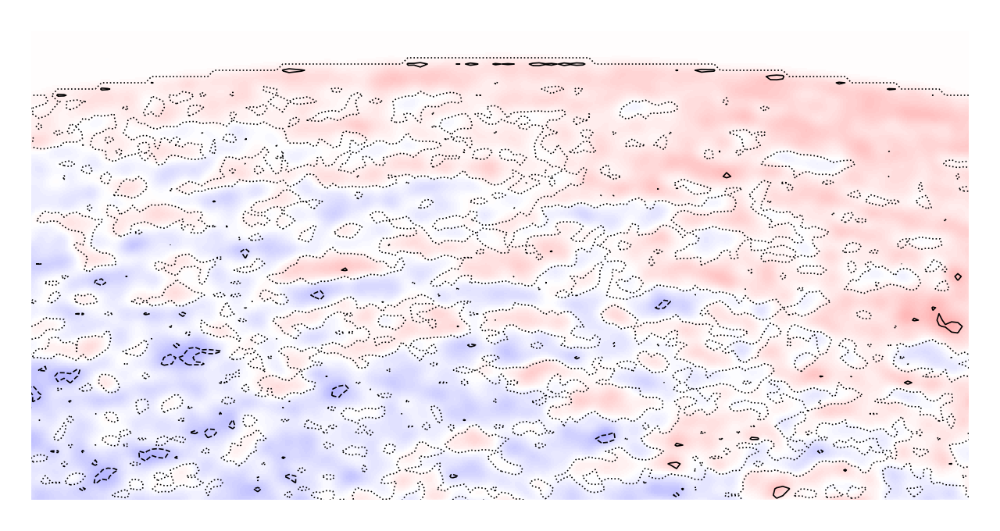

In [23]:

frame = 0
inx = np.argmin([np.abs(delta.total_seconds()) for delta in datetime.fromisoformat(hmi_mdi_fits_rp_l[frame].meta['date-obs'])-mdi_dates])

vlim = np.max(np.abs(hmi_mdi_fits_rp_l[frame].data))

# Size definitions
dpi = 400
pxx = w_width*2   # Horizontal size of each panel
pxy = w_height*2   # Vertical size of each panel

nph = 1     # Number of horizontal panels
npv = 2     # Number of vertical panels 

# Padding
padv  = 0  #Vertical padding in pixels
padv2 = 0  #Vertical padding in pixels between panels
padh  = 0 #Horizontal padding in pixels at the edge of the figure
padh2 = 50  #Horizontal padding in pixels between panels

# Figure sizes in pixels
fszv = (npv*pxy + 2*padv + (npv-1)*padv2 )      #Vertical size of figure in pixels
fszh = (nph*pxx + 2*padh + (nph-1)*padh2 )      #Horizontal size of figure in pixels

# Conversion to relative units
ppxx   = pxx/fszh      # Horizontal size of each panel in relative units
ppxy   = pxy/fszv      # Vertical size of each panel in relative units
ppadv  = padv/fszv     #Vertical padding in relative units
ppadv2 = padv2/fszv    #Vertical padding in relative units
ppadh  = padh/fszh     #Horizontal padding the edge of the figure in relative units
ppadh2 = padh2/fszh    #Horizontal padding between panels in relative units


## Start Figure
fig = plt.figure(figsize=(fszh/dpi,fszv/dpi), dpi = dpi)

# Inferred
ax1 = fig.add_axes([ppadh, ppadv, ppxx, ppxy])
# ax1.imshow(hmi_mdi_fits_rp_l[frame].data, vmin=-vlim, vmax=vlim, cmap = current_cmap, origin='lower')
ax1.imshow(hmi_mdi_fits_rps_l[frame].data, vmin=-vlim, vmax=vlim, cmap = current_cmap, origin='lower')

vlim_lr = np.max(np.abs(mdi_fits_l[inx].data))

nc = 4

x, y = np.meshgrid(*[np.arange(v.value) for v in mdi_fits_l[inx].dimensions])
ax1.contour(x*scale_factor+1, y*scale_factor+1, mdi_fits_l[inx].data, np.arange(-vlim_lr,0,vlim_lr/nc), colors='k', linestyles='--', linewidths=0.3)
ax1.contour(x*scale_factor+1, y*scale_factor+1, mdi_fits_l[inx].data, [0], colors='k', linestyles=':', linewidths=0.3)
ax1.contour(x*scale_factor+1, y*scale_factor+1, mdi_fits_l[inx].data, np.arange(vlim_lr/nc,vlim_lr+vlim_lr/nc,vlim_lr/nc), colors='k', linestyles='-', linewidths=0.3)


ax1.set_axis_off()
# ax1.text(0.99, 0.99, source, horizontalalignment='right', verticalalignment='top', color = 'k', transform=ax1.transAxes)
ax1.set_xlim([indices[0]-w_width//2, indices[0]+w_width//2])
ax1.set_ylim([indices[1]-w_height//2, indices[1]+w_height//2])


# ax2 = fig.add_axes([ppadh, ppadv+ppxy, ppxx, ppxy])
# ax2.imshow(mdi_hmi_map.data, vmin=vmin, vmax=vmax, cmap = current_cmap, origin='lower')
# ax2.set_axis_off()
# ax2.text(0.99, 0.99, 'HMI Target', horizontalalignment='right', verticalalignment='top', color = 'k', transform=ax2.transAxes)
# ax2.set_xlim([indices[0]-w_width//2, indices[0]+w_width//2])
# ax2.set_ylim([indices[0]-w_height//2, indices[0]+w_height//2])


# ax3 = fig.add_axes([ppadh, ppadv-ppxy, ppxx, ppxy])
# ax3.imshow(mdi_hmi_map.data-MDImap.data, vmin=vmin, vmax=vmax, cmap = current_cmap, origin='lower')
# ax3.set_axis_off()
# ax3.text(0.99, 0.99, 'Difference', horizontalalignment='right', verticalalignment='top', color = 'k', transform=ax3.transAxes)
# ax3.set_xlim([indices[0]-w_width//2, indices[0]+w_width//2])
# ax3.set_ylim([indices[0]-w_height//2, indices[0]+w_height//2])

# fig.savefig(label + '_FD.png', bbox_inches='tight', dpi = dpi, pad_inches=0)

## Reproject `hmi_map` to `gong_map` and create smoothed version

0it [00:00, ?it/s]

2010-06-01T23:45:40.500 0 2010-06-01 23:46:11


1it [00:27, 27.08s/it]

2010-06-01T23:46:25.500 0 2010-06-01 23:46:11


2it [00:53, 26.90s/it]

2010-06-01T23:47:10.500 1 2010-06-01 23:47:11


3it [01:20, 26.77s/it]

2010-06-01T23:47:55.500 2 2010-06-01 23:48:11


4it [01:47, 26.73s/it]

2010-06-01T23:48:40.500 2 2010-06-01 23:48:11


5it [02:14, 26.86s/it]


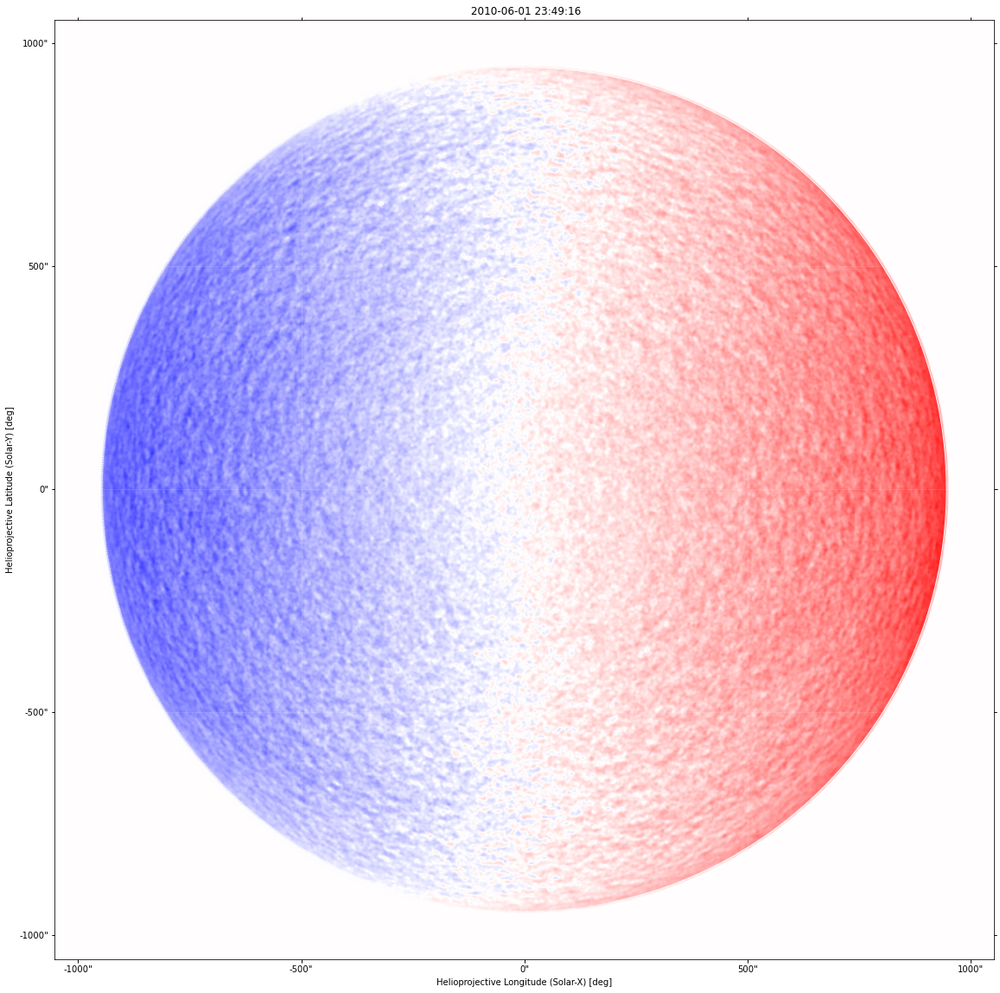

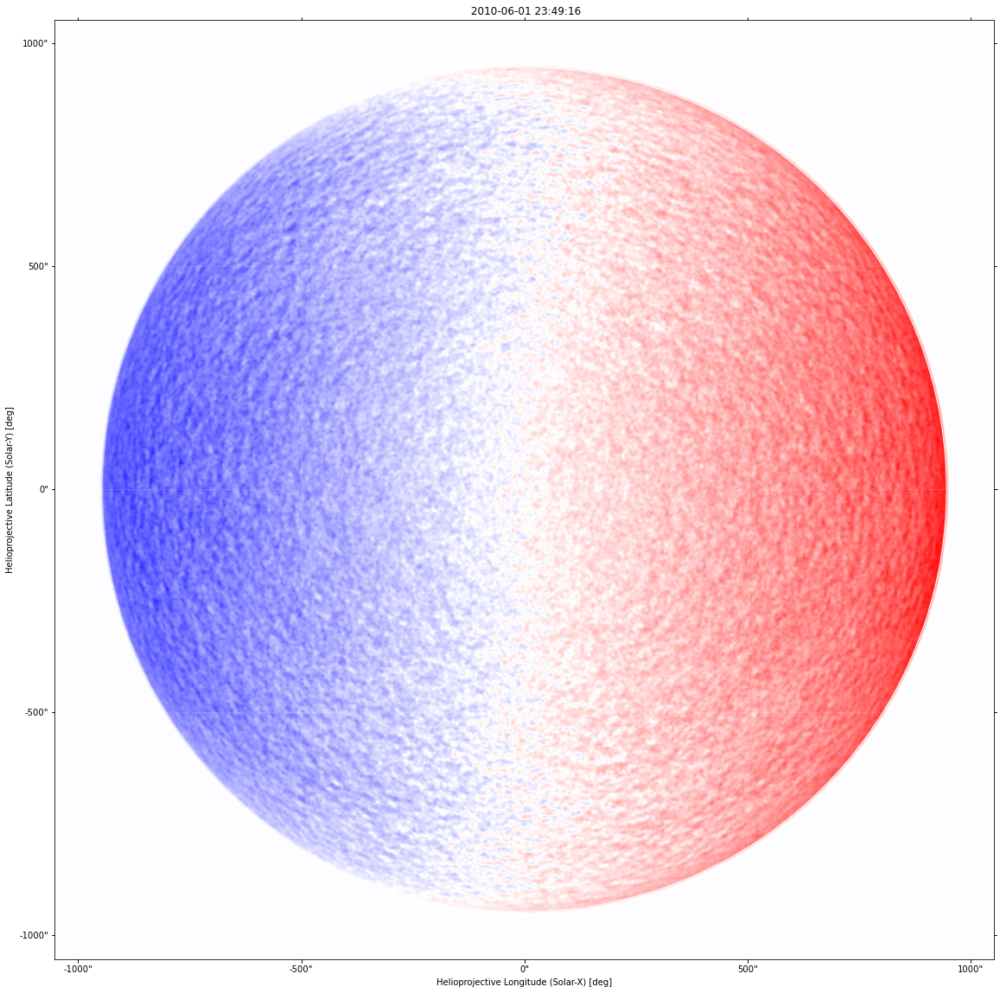

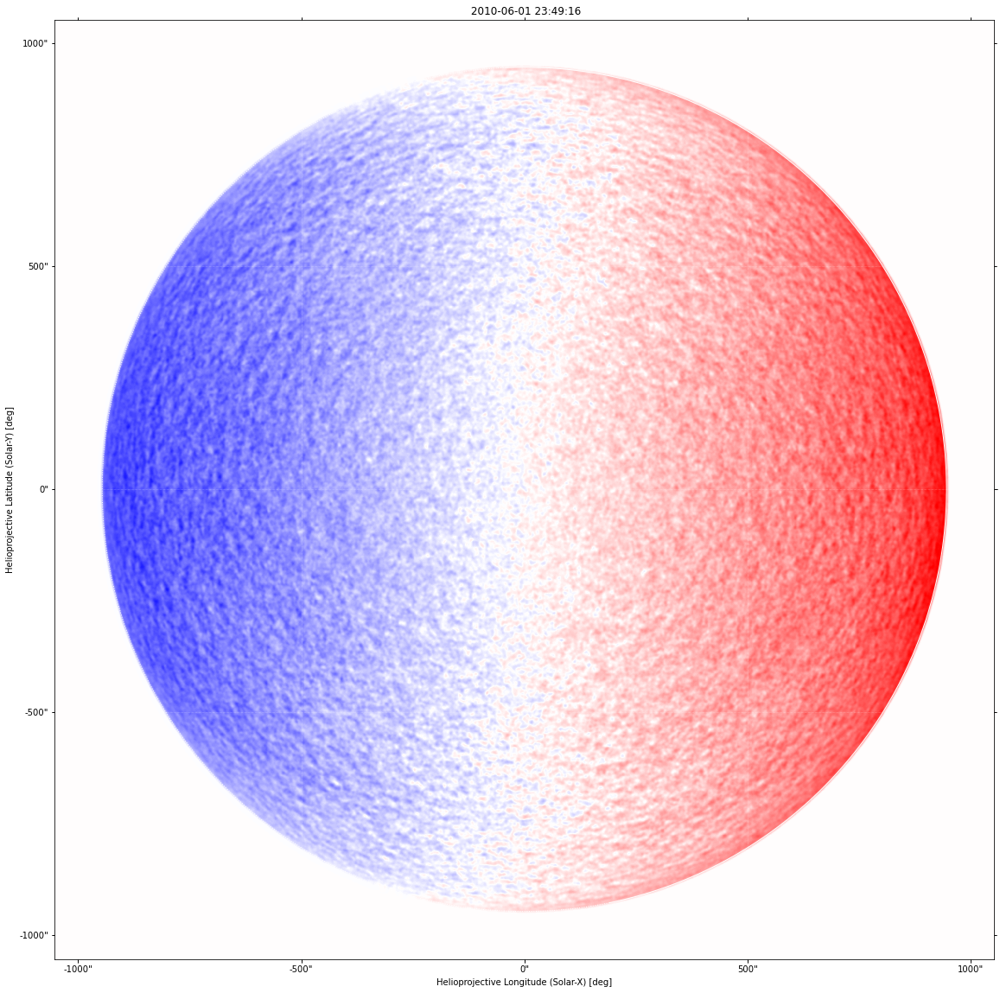

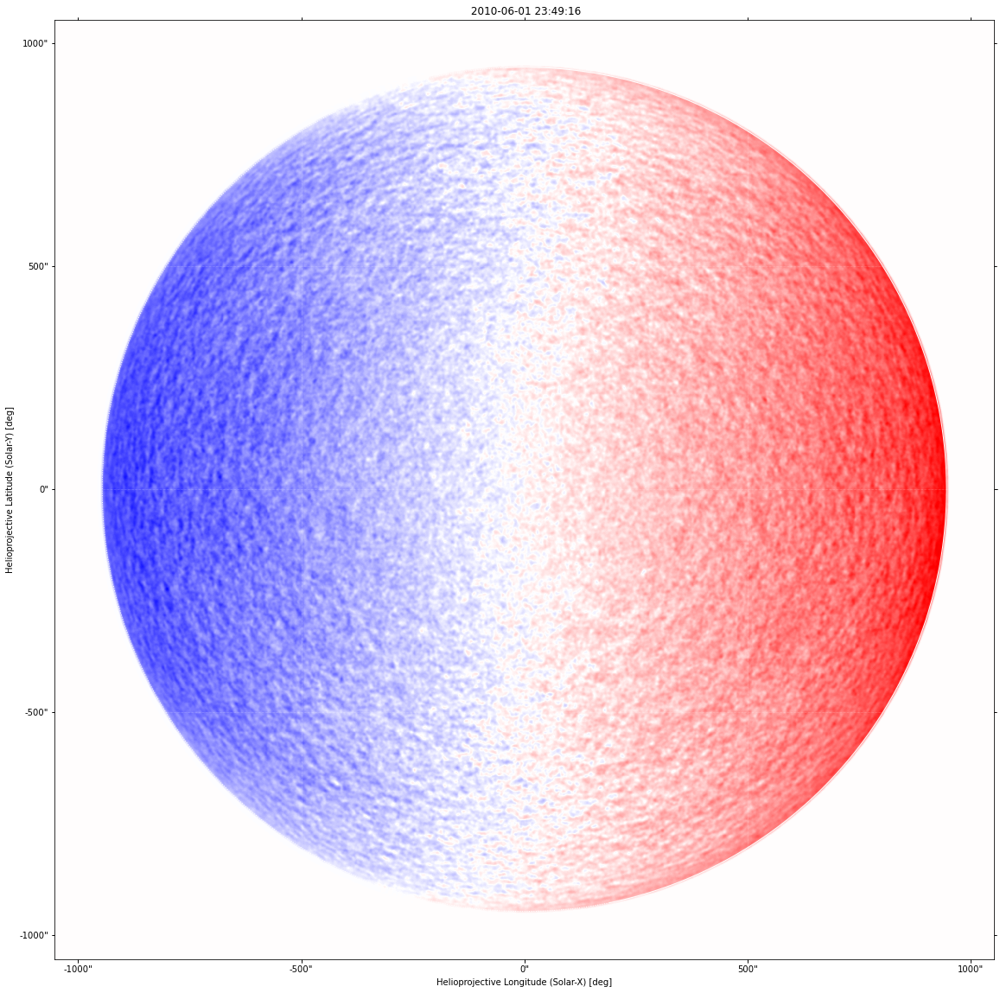

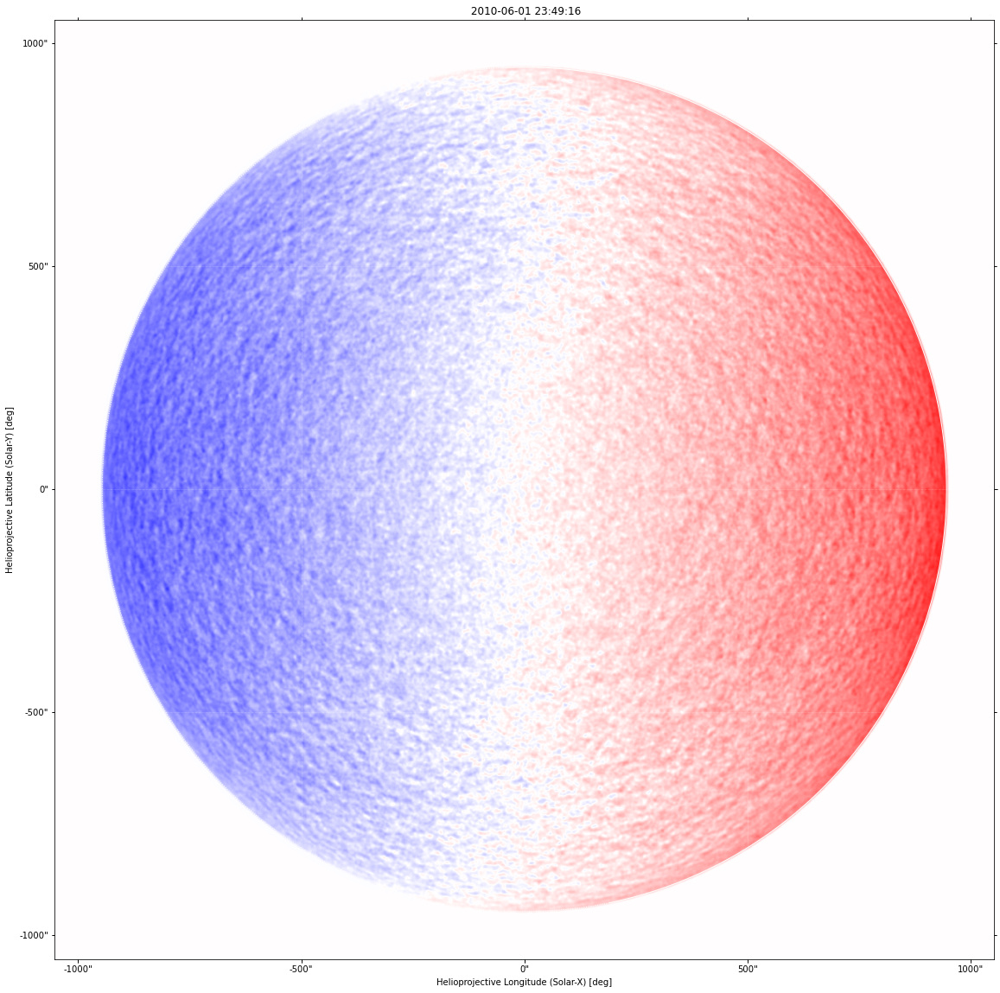

In [24]:
gong_dates = np.array([datetime.fromisoformat(dmap.meta['date-obs']) for dmap in gong_fits_hr_l])

hmi_gong_fits_rp_l = []
hmi_gong_fits_rps_l = []
for i,dmap in tqdm(enumerate(hmi_fits_l)):
    inx = np.argmin([np.abs(delta.total_seconds()) for delta in datetime.fromisoformat(dmap.meta['date-obs'])-gong_dates])
    print(dmap.meta['date-obs'], inx, mdi_dates[inx])
    
    output, footprint = reproject_interp(dmap, gong_fits_hr_l[inx].wcs, gong_fits_hr_l[inx].data.shape)
    gong_hmi_map = Map(output, gong_fits_hr_l[inx].wcs)
    
    x, y = np.meshgrid(*[np.arange(v.value) for v in gong_hmi_map.dimensions]) * u.pixel
    hpc_coords = gong_hmi_map.pixel_to_world(x, y)
    rSun = np.sqrt(hpc_coords.Tx ** 2 + hpc_coords.Ty ** 2) / gong_hmi_map.rsun_obs
    gong_hmi_map.data[rSun>1] = 0
    
    target_smooth = gaussian_filter(gong_hmi_map.data, scale_factor)
    target_smooth = Map(target_smooth, gongmap.wcs)    
    
    hmi_gong_fits_rp_l.append(gong_hmi_map)
    hmi_gong_fits_rps_l.append(target_smooth)
    
    plt.figure(figsize=(20,20))
    vlim = np.max(np.abs(gong_hmi_map.data))
#     gong_hmi_map.plot(norm = mpl.colors.Normalize(vmin=-vlim, vmax=vlim), cmap=current_cmap)
    target_smooth.plot(norm = mpl.colors.Normalize(vmin=-vlim, vmax=vlim), cmap=current_cmap)
    gong_hmi_map.draw_limb()    


In [25]:
plt.close('all')

In [26]:
# Find indices of strongest pixel
indices = np.array([int(14*gong_hmi_map.data.shape[0]/16), int(8*gong_hmi_map.data.shape[0]/16)])

# Specify dimensions of plotting window in pixels
w_width = 600
w_height = 300

(1514.0, 1814.0)

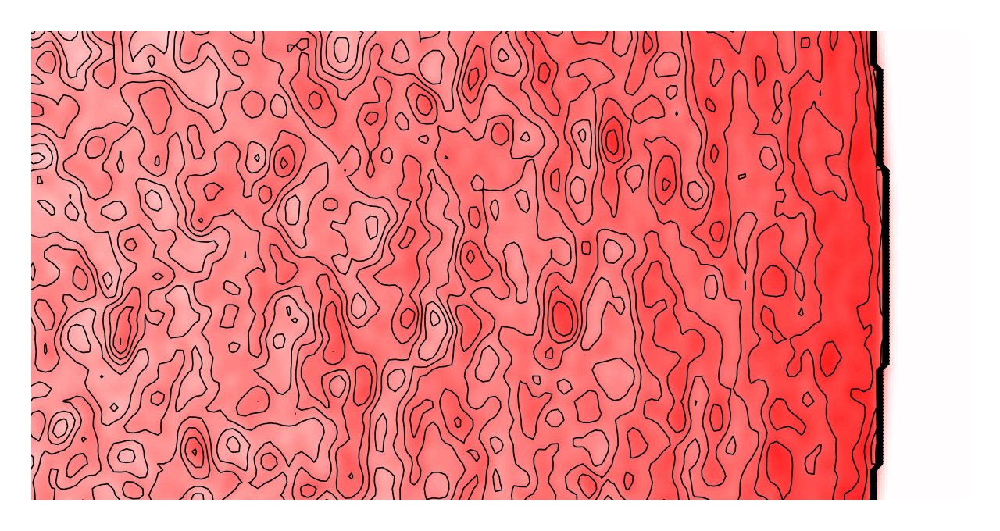

In [27]:

frame = 0
inx = np.argmin([np.abs(delta.total_seconds()) for delta in datetime.fromisoformat(hmi_gong_fits_rp_l[frame].meta['date-obs'])-gong_dates])

vlim = np.max(np.abs(hmi_gong_fits_rp_l[frame].data))

# Size definitions
dpi = 400
pxx = w_width*2   # Horizontal size of each panel
pxy = w_height*2   # Vertical size of each panel

nph = 1     # Number of horizontal panels
npv = 2     # Number of vertical panels 

# Padding
padv  = 0  #Vertical padding in pixels
padv2 = 0  #Vertical padding in pixels between panels
padh  = 0 #Horizontal padding in pixels at the edge of the figure
padh2 = 50  #Horizontal padding in pixels between panels

# Figure sizes in pixels
fszv = (npv*pxy + 2*padv + (npv-1)*padv2 )      #Vertical size of figure in pixels
fszh = (nph*pxx + 2*padh + (nph-1)*padh2 )      #Horizontal size of figure in pixels

# Conversion to relative units
ppxx   = pxx/fszh      # Horizontal size of each panel in relative units
ppxy   = pxy/fszv      # Vertical size of each panel in relative units
ppadv  = padv/fszv     #Vertical padding in relative units
ppadv2 = padv2/fszv    #Vertical padding in relative units
ppadh  = padh/fszh     #Horizontal padding the edge of the figure in relative units
ppadh2 = padh2/fszh    #Horizontal padding between panels in relative units


## Start Figure
fig = plt.figure(figsize=(fszh/dpi,fszv/dpi), dpi = dpi)

# Inferred
ax1 = fig.add_axes([ppadh, ppadv, ppxx, ppxy])
# ax1.imshow(hmi_gong_fits_rp_l[frame].data, vmin=-vlim, vmax=vlim, cmap = current_cmap, origin='lower')
ax1.imshow(hmi_gong_fits_rps_l[frame].data, vmin=-vlim, vmax=vlim, cmap = current_cmap, origin='lower')

vlim_lr = np.max(np.abs(gong_fits_l[inx].data))

nc = 20

x, y = np.meshgrid(*[np.arange(v.value) for v in gong_fits_l[inx].dimensions])
ax1.contour(x*scale_factor+1, y*scale_factor+1, gong_fits_l[inx].data, np.arange(-vlim_lr,0,vlim_lr/nc), colors='k', linestyles='--', linewidths=0.3)
ax1.contour(x*scale_factor+1, y*scale_factor+1, gong_fits_l[inx].data, [0], colors='k', linestyles=':', linewidths=0.3)
ax1.contour(x*scale_factor+1, y*scale_factor+1, gong_fits_l[inx].data, np.arange(vlim_lr/nc,vlim_lr+vlim_lr/nc,vlim_lr/nc), colors='k', linestyles='-', linewidths=0.3)


ax1.set_axis_off()
# ax1.text(0.99, 0.99, source, horizontalalignment='right', verticalalignment='top', color = 'k', transform=ax1.transAxes)
ax1.set_xlim([indices[0]-w_width//2, indices[0]+w_width//2])
ax1.set_ylim([indices[1]-w_height//2, indices[1]+w_height//2])


# ax2 = fig.add_axes([ppadh, ppadv+ppxy, ppxx, ppxy])
# ax2.imshow(gong_hmi_map.data, vmin=vmin, vmax=vmax, cmap = current_cmap, origin='lower')
# ax2.set_axis_off()
# ax2.text(0.99, 0.99, 'HMI Target', horizontalalignment='right', verticalalignment='top', color = 'k', transform=ax2.transAxes)
# ax2.set_xlim([indices[0]-w_width//2, indices[0]+w_width//2])
# ax2.set_ylim([indices[0]-w_height//2, indices[0]+w_height//2])


# ax3 = fig.add_axes([ppadh, ppadv-ppxy, ppxx, ppxy])
# ax3.imshow(gong_hmi_map.data-gongmap.data, vmin=vmin, vmax=vmax, cmap = current_cmap, origin='lower')
# ax3.set_axis_off()
# ax3.text(0.99, 0.99, 'Difference', horizontalalignment='right', verticalalignment='top', color = 'k', transform=ax3.transAxes)
# ax3.set_xlim([indices[0]-w_width//2, indices[0]+w_width//2])
# ax3.set_ylim([indices[0]-w_height//2, indices[0]+w_height//2])

# fig.savefig(label + '_FD.png', bbox_inches='tight', dpi = dpi, pad_inches=0)

## Create MDI patches

In [28]:
patchscale = 32
stridescale = 32

lr_patch_size = int(mdi_fits_l[0].data.shape[0] / patchscale)
lr_stride = int(mdi_fits_l[0].data.shape[0] / stridescale)
hr_patch_size = lr_patch_size * scale_factor
hr_stride = lr_stride * scale_factor

# Ratio of patch side to use as padding on all sides
buffer = 1/4


# mdi_scale = int(hmi_mdi_fits_rps_l[0].data.shape[0]/32)

mdi_hmi_t_p_l = []
mdi_hmi_t_pp_l = []

mdi_hmi_ts_p_l = []
mdi_hmi_ts_pp_l = []

mdi_hmi_s_p_l = []
mdi_hmi_su_p_l = []

for target_smooth,target_map in tqdm(zip(hmi_mdi_fits_rps_l, hmi_mdi_fits_rp_l)):
    
    inx = np.argmin([np.abs(delta.total_seconds()) for delta in datetime.fromisoformat(target_map.meta['date-obs'])-mdi_dates])
  
    ##################################################
    # Target map
    ##################################################
    
    target_patch = tf.image.extract_patches(images=target_map.data[None,:,:,None],
                                       sizes=[1, hr_patch_size, hr_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    target_patch = tf.reshape(target_patch, [1, patchscale, patchscale, hr_patch_size, hr_patch_size]).numpy()[0,:,:,:,:]
    
    mdi_hmi_t_p_l.append(target_patch)
    
    
    ##################################################
    # Target map - Padded
    ##################################################
    
    target_map_padded = np.pad(target_map.data, int(hr_patch_size * buffer), mode='constant', constant_values=0)

    # New header for padded
    new_meta = target_map.meta.copy()
    new_meta['crpix1'] = new_meta['crpix1'] - target_map.data.shape[0] / 2 + target_map_padded.shape[0] / 2
    new_meta['crpix2'] = new_meta['crpix2'] - target_map.data.shape[1] / 2 + target_map_padded.shape[1] / 2

    padded_patch_size = int(hr_patch_size * (1 + 2*buffer))
    target_map_padded = Map(target_map_padded, new_meta)
    target_map_padded_patch = tf.image.extract_patches(images=target_map_padded.data[None,:,:,None],
                                       sizes=[1, padded_patch_size, padded_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    
    target_map_padded_patch = tf.reshape(target_map_padded_patch, [1, patchscale, patchscale, padded_patch_size, padded_patch_size]).numpy()[0,:,:,:,:]
    
    mdi_hmi_t_pp_l.append(target_map_padded_patch)
    

    ##################################################
    # Target Smoothed map
    ##################################################    
    
    target_smooth_patch = tf.image.extract_patches(images=target_smooth.data[None,:,:,None],
                                       sizes=[1, hr_patch_size, hr_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    target_smooth_patch = tf.reshape(target_smooth_patch, [1, patchscale, patchscale, hr_patch_size, hr_patch_size]).numpy()[0,:,:,:,:]
    
    mdi_hmi_ts_p_l.append(target_smooth_patch)
    
    
    ##################################################
    # Target Smoothed map - Padded
    ##################################################  
    
    # Padded target smoothed map
    target_smooth_padded = np.pad(target_smooth.data, int(hr_patch_size * buffer), mode='constant', constant_values=0)
    target_smooth_padded = Map(target_smooth_padded, new_meta)
    target_smooth_padded_patch = tf.image.extract_patches(images=target_smooth_padded.data[None,:,:,None],
                                       sizes=[1, padded_patch_size, padded_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    
    target_smooth_padded_patch = tf.reshape(target_smooth_padded_patch, [1, patchscale, patchscale, padded_patch_size, padded_patch_size]).numpy()[0,:,:,:,:]   

    mdi_hmi_ts_pp_l.append(target_smooth_padded_patch)

    
    ##################################################
    # Source map
    ##################################################
    
    source_patch = tf.image.extract_patches(images=mdi_fits_l[inx].data[None,:,:,None],
                                       sizes=[1, lr_patch_size, lr_patch_size, 1],
                                       strides=[1, lr_stride, lr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    source_patch = tf.reshape(source_patch, [1, patchscale, patchscale, lr_patch_size, lr_patch_size]).numpy()[0,:,:,:,:]
    
    mdi_hmi_s_p_l.append(source_patch)
    
    
    ##################################################
    # Source map - Upscaled
    ##################################################    
    
    source_upsampled_patch = tf.image.extract_patches(images=mdi_fits_hr_l[inx].data[None,:,:,None],
                                       sizes=[1, hr_patch_size, hr_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    
    source_upsampled_patch = tf.reshape(source_upsampled_patch, [1, patchscale, patchscale, hr_patch_size, hr_patch_size]).numpy()[0,:,:,:,:]
    
    mdi_hmi_su_p_l.append(source_upsampled_patch)






5it [00:01,  2.56it/s]


In [29]:
mdi_hmi_t_p_l[0].shape
# mdi_hmi_t_pp_l[0].shape

# mdi_hmi_ts_p_l[0].shape
# mdi_hmi_ts_pp_l[0].shape

# mdi_hmi_s_p_l[0].shape
# mdi_hmi_su_p_l[0].shape

(32, 32, 128, 128)

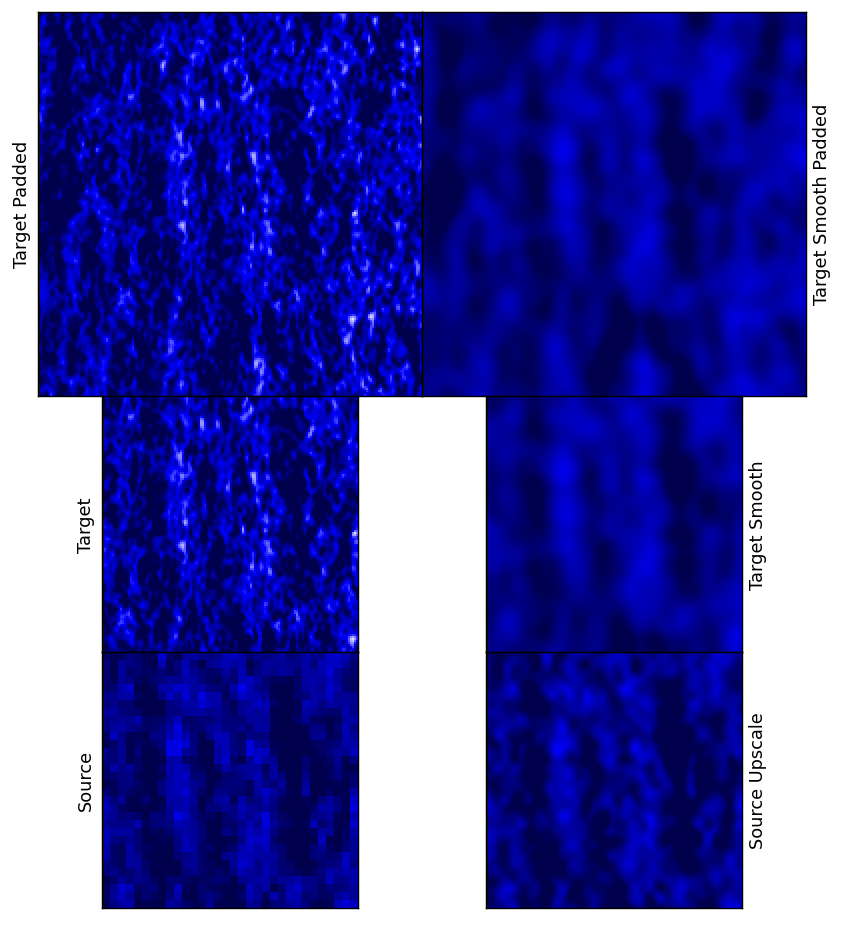

In [30]:
inxy=16
inxx=2
frame = 0

# Size definitions
dpi = 128
pxx = hr_patch_size*2   # Horizontal size of each panel
pxy = hr_patch_size*2   # Vertical size of each panel

nph = 1     # Number of horizontal panels
npv = 1     # Number of vertical panels 

# Padding
padv  = 0  #Vertical padding in pixels
padv2 = 0  #Vertical padding in pixels between panels
padh  = 0 #Horizontal padding in pixels at the edge of the figure
padh2 = 50  #Horizontal padding in pixels between panels

# Figure sizes in pixels
fszv = (npv*pxy + 2*padv + (npv-1)*padv2 )      #Vertical size of figure in pixels
fszh = (nph*pxx + 2*padh + (nph-1)*padh2 )      #Horizontal size of figure in pixels

# Conversion to relative units
ppxx   = pxx/fszh      # Horizontal size of each panel in relative units
ppxy   = pxy/fszv      # Vertical size of each panel in relative units
ppadv  = padv/fszv     #Vertical padding in relative units
ppadv2 = padv2/fszv    #Vertical padding in relative units
ppadh  = padh/fszh     #Horizontal padding the edge of the figure in relative units
ppadh2 = padh2/fszh    #Horizontal padding between panels in relative units


## Start Figure
fig = plt.figure(figsize=(fszh/dpi,fszv/dpi), dpi = dpi)

ax1 = fig.add_axes([ppadh, ppadv, ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
ax1.imshow(mdi_hmi_t_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax1.set_axis_off()
ax1.set_ylabel('Target Padded')
ax1.set_yticks([])
ax1.set_xticks([])

ax2 = fig.add_axes([ppadh+ppxx*(1+2*buffer), ppadv, ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
ax2.imshow(mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax2.set_ylabel('Target Smooth Padded')
ax2.set_yticks([])
ax2.set_xticks([])
ax2.yaxis.set_label_position("right")


ax3 = fig.add_axes([ppadh+ppxx*buffer, ppadv-ppxy, ppxx, ppxy])
ax3.imshow(mdi_hmi_t_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax3.set_ylabel('Target')
ax3.set_yticks([])
ax3.set_xticks([])


ax4 = fig.add_axes([ppadh+ppxx*(1+3*buffer), ppadv-ppxy, ppxx, ppxy])
ax4.imshow(mdi_hmi_ts_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax4.set_ylabel('Target Smooth')
ax4.set_yticks([])
ax4.set_xticks([])
ax4.yaxis.set_label_position("right")


ax5 = fig.add_axes([ppadh+ppxx*buffer, ppadv-2*ppxy, ppxx, ppxy])
ax5.imshow(mdi_hmi_s_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax5.set_ylabel('Source')
ax5.set_yticks([])
ax5.set_xticks([])


ax6 = fig.add_axes([ppadh+ppxx*(1+3*buffer), ppadv-2*ppxy, ppxx, ppxy])
ax6.imshow(mdi_hmi_su_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax6.set_ylabel('Source Upscale')
ax6.set_yticks([])
ax6.set_xticks([])
ax6.yaxis.set_label_position("right")


## Create GONG patches

In [31]:
patchscale = 32
stridescale = 32

lr_patch_size = int(gong_fits_l[0].data.shape[0] / patchscale)
lr_stride = int(gong_fits_l[0].data.shape[0] / stridescale)
hr_patch_size = lr_patch_size * scale_factor
hr_stride = lr_stride * scale_factor

# Ratio of patch side to use as padding on all sides
buffer = 1/4


# gong_scale = int(hmi_gong_fits_rps_l[0].data.shape[0]/32)

gong_hmi_t_p_l = []
gong_hmi_t_pp_l = []

gong_hmi_ts_p_l = []
gong_hmi_ts_pp_l = []

gong_hmi_s_p_l = []
gong_hmi_su_p_l = []

for target_smooth,target_map in tqdm(zip(hmi_gong_fits_rps_l, hmi_gong_fits_rp_l)):
    
    inx = np.argmin([np.abs(delta.total_seconds()) for delta in datetime.fromisoformat(target_map.meta['date-obs'])-gong_dates])
  
    ##################################################
    # Target map
    ##################################################
    
    target_patch = tf.image.extract_patches(images=target_map.data[None,:,:,None],
                                       sizes=[1, hr_patch_size, hr_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    target_patch = tf.reshape(target_patch, [1, patchscale, patchscale, hr_patch_size, hr_patch_size]).numpy()[0,:,:,:,:]
    
    gong_hmi_t_p_l.append(target_patch)
    
    
    ##################################################
    # Target map - Padded
    ##################################################
    
    target_map_padded = np.pad(target_map.data, int(hr_patch_size * buffer), mode='constant', constant_values=0)

    # New header for padded
    new_meta = target_map.meta.copy()
    new_meta['crpix1'] = new_meta['crpix1'] - target_map.data.shape[0] / 2 + target_map_padded.shape[0] / 2
    new_meta['crpix2'] = new_meta['crpix2'] - target_map.data.shape[1] / 2 + target_map_padded.shape[1] / 2

    padded_patch_size = int(hr_patch_size * (1 + 2*buffer))
    target_map_padded = Map(target_map_padded, new_meta)
    target_map_padded_patch = tf.image.extract_patches(images=target_map_padded.data[None,:,:,None],
                                       sizes=[1, padded_patch_size, padded_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    
    target_map_padded_patch = tf.reshape(target_map_padded_patch, [1, patchscale, patchscale, padded_patch_size, padded_patch_size]).numpy()[0,:,:,:,:]
    
    gong_hmi_t_pp_l.append(target_map_padded_patch)
    

    ##################################################
    # Target Smoothed map
    ##################################################    
    
    target_smooth_patch = tf.image.extract_patches(images=target_smooth.data[None,:,:,None],
                                       sizes=[1, hr_patch_size, hr_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    target_smooth_patch = tf.reshape(target_smooth_patch, [1, patchscale, patchscale, hr_patch_size, hr_patch_size]).numpy()[0,:,:,:,:]
    
    gong_hmi_ts_p_l.append(target_smooth_patch)
    
    
    ##################################################
    # Target Smoothed map - Padded
    ##################################################  
    
    # Padded target smoothed map
    target_smooth_padded = np.pad(target_smooth.data, int(hr_patch_size * buffer), mode='constant', constant_values=0)
    target_smooth_padded = Map(target_smooth_padded, new_meta)
    target_smooth_padded_patch = tf.image.extract_patches(images=target_smooth_padded.data[None,:,:,None],
                                       sizes=[1, padded_patch_size, padded_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    
    target_smooth_padded_patch = tf.reshape(target_smooth_padded_patch, [1, patchscale, patchscale, padded_patch_size, padded_patch_size]).numpy()[0,:,:,:,:]   

    gong_hmi_ts_pp_l.append(target_smooth_padded_patch)

    
    ##################################################
    # Source map
    ##################################################
    
    source_patch = tf.image.extract_patches(images=gong_fits_l[inx].data[None,:,:,None],
                                       sizes=[1, lr_patch_size, lr_patch_size, 1],
                                       strides=[1, lr_stride, lr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    source_patch = tf.reshape(source_patch, [1, patchscale, patchscale, lr_patch_size, lr_patch_size]).numpy()[0,:,:,:,:]
    
    gong_hmi_s_p_l.append(source_patch)
    
    
    ##################################################
    # Source map - Upscaled
    ##################################################    
    
    source_upsampled_patch = tf.image.extract_patches(images=gong_fits_hr_l[inx].data[None,:,:,None],
                                       sizes=[1, hr_patch_size, hr_patch_size, 1],
                                       strides=[1, hr_stride, hr_stride, 1],
                                       rates=[1, 1, 1, 1],
                                       padding='VALID')
    
    source_upsampled_patch = tf.reshape(source_upsampled_patch, [1, patchscale, patchscale, hr_patch_size, hr_patch_size]).numpy()[0,:,:,:,:]
    
    gong_hmi_su_p_l.append(source_upsampled_patch)






5it [00:01,  3.96it/s]


In [32]:
gong_hmi_t_p_l[0].shape
# gong_hmi_t_pp_l[0].shape

# gong_hmi_ts_p_l[0].shape
# gong_hmi_ts_pp_l[0].shape

# gong_hmi_s_p_l[0].shape
# gong_hmi_su_p_l[0].shape

(32, 32, 104, 104)

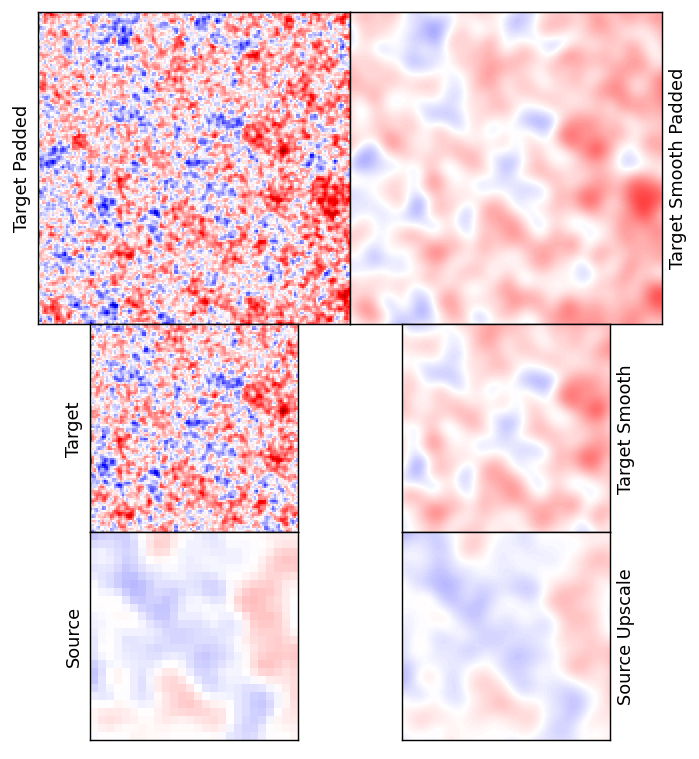

In [33]:
inxy=16
inxx=16
frame = 0

# Size definitions
dpi = 128
pxx = hr_patch_size*2   # Horizontal size of each panel
pxy = hr_patch_size*2   # Vertical size of each panel

nph = 1     # Number of horizontal panels
npv = 1     # Number of vertical panels 

# Padding
padv  = 0  #Vertical padding in pixels
padv2 = 0  #Vertical padding in pixels between panels
padh  = 0 #Horizontal padding in pixels at the edge of the figure
padh2 = 50  #Horizontal padding in pixels between panels

# Figure sizes in pixels
fszv = (npv*pxy + 2*padv + (npv-1)*padv2 )      #Vertical size of figure in pixels
fszh = (nph*pxx + 2*padh + (nph-1)*padh2 )      #Horizontal size of figure in pixels

# Conversion to relative units
ppxx   = pxx/fszh      # Horizontal size of each panel in relative units
ppxy   = pxy/fszv      # Vertical size of each panel in relative units
ppadv  = padv/fszv     #Vertical padding in relative units
ppadv2 = padv2/fszv    #Vertical padding in relative units
ppadh  = padh/fszh     #Horizontal padding the edge of the figure in relative units
ppadh2 = padh2/fszh    #Horizontal padding between panels in relative units


## Start Figure
fig = plt.figure(figsize=(fszh/dpi,fszv/dpi), dpi = dpi)

ax1 = fig.add_axes([ppadh, ppadv, ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
ax1.imshow(gong_hmi_t_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax1.set_axis_off()
ax1.set_ylabel('Target Padded')
ax1.set_yticks([])
ax1.set_xticks([])

ax2 = fig.add_axes([ppadh+ppxx*(1+2*buffer), ppadv, ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
ax2.imshow(gong_hmi_ts_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax2.set_ylabel('Target Smooth Padded')
ax2.set_yticks([])
ax2.set_xticks([])
ax2.yaxis.set_label_position("right")


ax3 = fig.add_axes([ppadh+ppxx*buffer, ppadv-ppxy, ppxx, ppxy])
ax3.imshow(gong_hmi_t_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax3.set_ylabel('Target')
ax3.set_yticks([])
ax3.set_xticks([])


ax4 = fig.add_axes([ppadh+ppxx*(1+3*buffer), ppadv-ppxy, ppxx, ppxy])
ax4.imshow(gong_hmi_ts_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax4.set_ylabel('Target Smooth')
ax4.set_yticks([])
ax4.set_xticks([])
ax4.yaxis.set_label_position("right")


ax5 = fig.add_axes([ppadh+ppxx*buffer, ppadv-2*ppxy, ppxx, ppxy])
ax5.imshow(gong_hmi_s_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax5.set_ylabel('Source')
ax5.set_yticks([])
ax5.set_xticks([])


ax6 = fig.add_axes([ppadh+ppxx*(1+3*buffer), ppadv-2*ppxy, ppxx, ppxy])
ax6.imshow(gong_hmi_su_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
ax6.set_ylabel('Source Upscale')
ax6.set_yticks([])
ax6.set_xticks([])
ax6.yaxis.set_label_position("right")


## Template match MDI patches

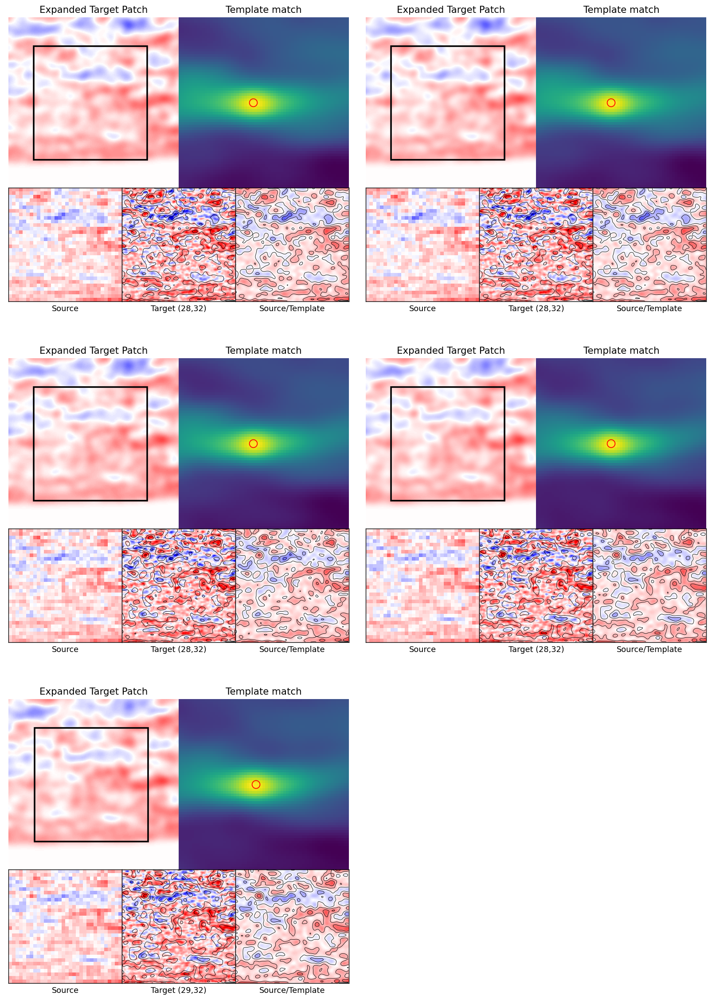

In [82]:
inxy=30
inxx=16
frame = 0

lr_patch_size = int(mdi_fits_l[0].data.shape[0] / patchscale)
lr_stride = int(mdi_fits_l[0].data.shape[0] / stridescale)
hr_patch_size = lr_patch_size * scale_factor
hr_stride = lr_stride * scale_factor

# Size definitions
dpi = 128
pxx = hr_patch_size*2   # Horizontal size of each panel
pxy = hr_patch_size*2   # Vertical size of each panel

nph = 1     # Number of horizontal panels
npv = 1     # Number of vertical panels 

# Padding
padv  = 0  #Vertical padding in pixels
padv2 = 0  #Vertical padding in pixels between panels
padh  = 0 #Horizontal padding in pixels at the edge of the figure
padh2 = 50  #Horizontal padding in pixels between panels

# Figure sizes in pixels
fszv = (npv*pxy + 2*padv + (npv-1)*padv2 )      #Vertical size of figure in pixels
fszh = (nph*pxx + 2*padh + (nph-1)*padh2 )      #Horizontal size of figure in pixels

# Conversion to relative units
ppxx   = pxx/fszh      # Horizontal size of each panel in relative units
ppxy   = pxy/fszv      # Vertical size of each panel in relative units
ppadv  = padv/fszv     #Vertical padding in relative units
ppadv2 = padv2/fszv    #Vertical padding in relative units
ppadh  = padh/fszh     #Horizontal padding the edge of the figure in relative units
ppadh2 = padh2/fszh    #Horizontal padding between panels in relative units


## Start Figure
fig = plt.figure(figsize=(fszh/dpi,fszv/dpi), dpi = dpi)

for frame in range(len(mdi_hmi_s_p_l)):
    
    result = match_template(mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:], mdi_hmi_su_p_l[frame][inxy,inxx,:,:])
    ij = np.unravel_index(np.argmax(result), result.shape)
    x, y = ij[::-1]
    
    
    ax2 = fig.add_axes([ppadh+2.1*(frame%2)*ppxx*(1+2*buffer), ppadv-2*(frame//2)*ppxy*(1+2*buffer), ppxx*(1+2*buffer), ppxy*(1+2*buffer)])

    ax2.imshow(mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
    ax2.set_axis_off()
    ax2.set_title('Expanded Target Patch')
    # highlight matched region
    hcoin, wcoin = mdi_hmi_su_p_l[frame][inxy,inxx,:,:].shape
    rect = plt.Rectangle((x, y), wcoin, hcoin, edgecolor='k', facecolor='none', linewidth=2)
    ax2.add_patch(rect)   
    
    
    ax3 = fig.add_axes([ppadh+(2.1*(frame%2)*ppxx+1)*(1+2*buffer), ppadv-2*(frame//2)*ppxy*(1+2*buffer), ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
    
    ax3.imshow(result)
    ax3.set_axis_off()
    ax3.set_title('Template match')
    # highlight matched region
    ax3.autoscale(False)
    ax3.plot(x, y, 'o', markeredgecolor='r', markerfacecolor='none', markersize=10)
    
    
    ax1 = fig.add_axes([ppadh+2.1*(frame%2)*ppxx*(1+2*buffer), ppadv-2*(frame//2)*ppxy*(1+2*buffer)-ppxy, ppxx, ppxy])
    ax1.imshow(mdi_hmi_s_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
    ax1.set_yticks([])
    ax1.set_xticks([])
    ax1.set_xlabel('Source')
    
    
    dp = 1
    ax4 = fig.add_axes([ppadh+2.1*(frame%2)*ppxx*(1+2*buffer)+ppxx, ppadv-2*(frame//2)*ppxy*(1+2*buffer)-ppxy, ppxx, ppxy])
    ax4.imshow(mdi_hmi_t_pp_l[frame][inxy,inxx, y+dp:y+dp+hr_patch_size, x+dp:x+dp+hr_patch_size], vmin=vmin, vmax=vmax, cmap=current_cmap)
    ax4.set_yticks([])
    ax4.set_xticks([])
    ax4.set_xlabel(f'Target ({x},{y})')
    
    x, y = np.meshgrid(*[np.arange(v) for v in mdi_hmi_su_p_l[frame][inxy,inxx,:,:].shape])
    ax4.contour(x,y,mdi_hmi_su_p_l[frame][inxy,inxx,:,:], 5,colors='k', linestyles='-', linewidths=0.5)    
    
    ax5 = fig.add_axes([ppadh+2.1*(frame%2)*ppxx*(1+2*buffer)+2*ppxx, ppadv-2*(frame//2)*ppxy*(1+2*buffer)-ppxy, ppxx, ppxy])
    ax5.imshow(mdi_hmi_su_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
    ax5.set_yticks([])
    ax5.set_xticks([])
    ax5.set_xlabel('Source/Template')    

    x, y = np.meshgrid(*[np.arange(v) for v in mdi_hmi_su_p_l[frame][inxy,inxx,:,:].shape])
    ax5.contour(x,y,mdi_hmi_su_p_l[frame][inxy,inxx,:,:], 5,colors='k', linestyles='-', linewidths=0.5)
    
    
# ax1 = fig.add_axes([ppadh, ppadv, ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
# ax1.imshow(mdi_hmi_t_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# # ax1.set_axis_off()
# ax1.set_ylabel('Target Padded')
# ax1.set_yticks([])
# ax1.set_xticks([])

# ax2 = fig.add_axes([ppadh+ppxx*(1+2*buffer), ppadv, ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
# ax2.imshow(mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax2.set_ylabel('Target Smooth Padded')
# ax2.set_yticks([])
# ax2.set_xticks([])
# ax2.yaxis.set_label_position("right")


# ax3 = fig.add_axes([ppadh+ppxx*buffer, ppadv-ppxy, ppxx, ppxy])
# ax3.imshow(mdi_hmi_t_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax3.set_ylabel('Target')
# ax3.set_yticks([])
# ax3.set_xticks([])


# ax4 = fig.add_axes([ppadh+ppxx*(1+3*buffer), ppadv-ppxy, ppxx, ppxy])
# ax4.imshow(mdi_hmi_ts_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax4.set_ylabel('Target Smooth')
# ax4.set_yticks([])
# ax4.set_xticks([])
# ax4.yaxis.set_label_position("right")


# ax5 = fig.add_axes([ppadh+ppxx*buffer, ppadv-2*ppxy, ppxx, ppxy])
# ax5.imshow(mdi_hmi_s_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax5.set_ylabel('Source')
# ax5.set_yticks([])
# ax5.set_xticks([])


# ax6 = fig.add_axes([ppadh+ppxx*(1+3*buffer), ppadv-2*ppxy, ppxx, ppxy])
# ax6.imshow(mdi_hmi_su_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax6.set_ylabel('Source Upscale')
# ax6.set_yticks([])
# ax6.set_xticks([])
# ax6.yaxis.set_label_position("right")

fig.savefig('Template_match1.png', bbox_inches='tight', dpi = dpi, pad_inches=0)


In [52]:
result.shape

(65, 65)

## Feature match MDI patches

Not enough matches are found - 2/2


error: OpenCV(4.5.1) ..\modules\calib3d\src\fundam.cpp:385: error: (-28:Unknown error code -28) The input arrays should have at least 4 corresponding point sets to calculate Homography in function 'cv::findHomography'


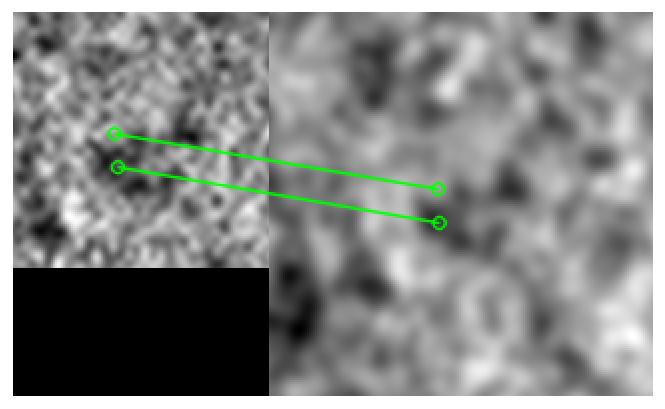

In [49]:
inxy=16
inxx=10

lr_patch_size = int(mdi_fits_l[0].data.shape[0] / patchscale)
lr_stride = int(mdi_fits_l[0].data.shape[0] / stridescale)
hr_patch_size = lr_patch_size * scale_factor
hr_stride = lr_stride * scale_factor

# Size definitions
dpi = 128
pxx = hr_patch_size*2   # Horizontal size of each panel
pxy = hr_patch_size*2   # Vertical size of each panel

nph = 1     # Number of horizontal panels
npv = 1     # Number of vertical panels 

# Padding
padv  = 0  #Vertical padding in pixels
padv2 = 0  #Vertical padding in pixels between panels
padh  = 0 #Horizontal padding in pixels at the edge of the figure
padh2 = 50  #Horizontal padding in pixels between panels

# Figure sizes in pixels
fszv = (npv*pxy + 2*padv + (npv-1)*padv2 )      #Vertical size of figure in pixels
fszh = (nph*pxx + 2*padh + (nph-1)*padh2 )      #Horizontal size of figure in pixels

# Conversion to relative units
ppxx   = pxx/fszh      # Horizontal size of each panel in relative units
ppxy   = pxy/fszv      # Vertical size of each panel in relative units
ppadv  = padv/fszv     #Vertical padding in relative units
ppadv2 = padv2/fszv    #Vertical padding in relative units
ppadh  = padh/fszh     #Horizontal padding the edge of the figure in relative units
ppadh2 = padh2/fszh    #Horizontal padding between panels in relative units

# Lists to store points

src_pts_l = []
dst_pts_l = []


## Pattern Matching definitiuon
sift = cv2.xfeatures2d.SIFT_create(nfeatures=100, contrastThreshold=0.0001)
MIN_MATCH_COUNT = 2
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

## Start Figure
fig = plt.figure(figsize=(fszh/dpi,fszv/dpi), dpi = dpi)

for frame in range(len(mdi_hmi_s_p_l)):
    
    ts_pp_norm = (mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:]-np.mean(mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:]))/np.std(mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:])/4+.5
    ts_pp_norm = cv2.normalize(ts_pp_norm, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    su_p_norm = (mdi_hmi_su_p_l[frame][inxy,inxx,:,:]-np.mean(mdi_hmi_su_p_l[frame][inxy,inxx,:,:]))/np.std(mdi_hmi_su_p_l[frame][inxy,inxx,:,:])/4+.5
    su_p_norm = cv2.normalize(su_p_norm, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    kp1, des1 = sift.detectAndCompute(su_p_norm, None)
    kp2, des2 = sift.detectAndCompute(ts_pp_norm, None)
    
    # find matches by knn which calculates point distance in 128 dim
    matches = flann.knnMatch(des1, des2, k=2)

    # store all the good matches as per Lowe's ratio test.
    good = []
    for m, n in matches:
        if m.distance < 0.7*n.distance:
            good.append(m)

    if len(good) > MIN_MATCH_COUNT:
        src_pts = np.float32(
            [kp1[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
        dst_pts = np.float32(
            [kp2[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)

#         # find homography
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
        matchesMask = mask.ravel().tolist()

        h, w = su_p_norm.shape
        pts = np.float32([[0, 0], [0, h-1], [w-1, h-1],
                          [w-1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(pts, M)  # matched coordinates

        affine = cv2.estimateAffinePartial2D(src_pts[:,0,:]+hr_patch_size*buffer, dst_pts[:,0,:]) 

        map_img = cv2.polylines(
            ts_pp_norm, [np.int32(dst)], True, 255, 3, cv2.LINE_AA)

    else:
        print("Not enough matches are found - %d/%d" %
              (len(good), MIN_MATCH_COUNT))
        matchesMask = None    
        
    draw_params = dict(matchColor=(0, 255, 0),  # draw matches in green color
                       singlePointColor=None,
#                        matchesMask=matchesMask,  # draw only inliers
                       flags=2)

    img3 = cv2.drawMatches(su_p_norm, kp1, ts_pp_norm, kp2,
                           good, None, **draw_params)        

    ax2 = fig.add_axes([ppadh+(frame%2)*ppxx*(2.1+2*buffer), ppadv-(frame//2)*ppxy*(1.1+2*buffer), ppxx*(2+2*buffer), ppxy*(1+2*buffer)])
    
    ax2.imshow(img3, 'gray')
    ax2.set_axis_off()
    
    src_pts_l += (src_pts[:,0,:]+hr_patch_size*buffer).tolist()
    dst_pts_l += dst_pts[:,0,:].tolist()

## Template match GONG patches

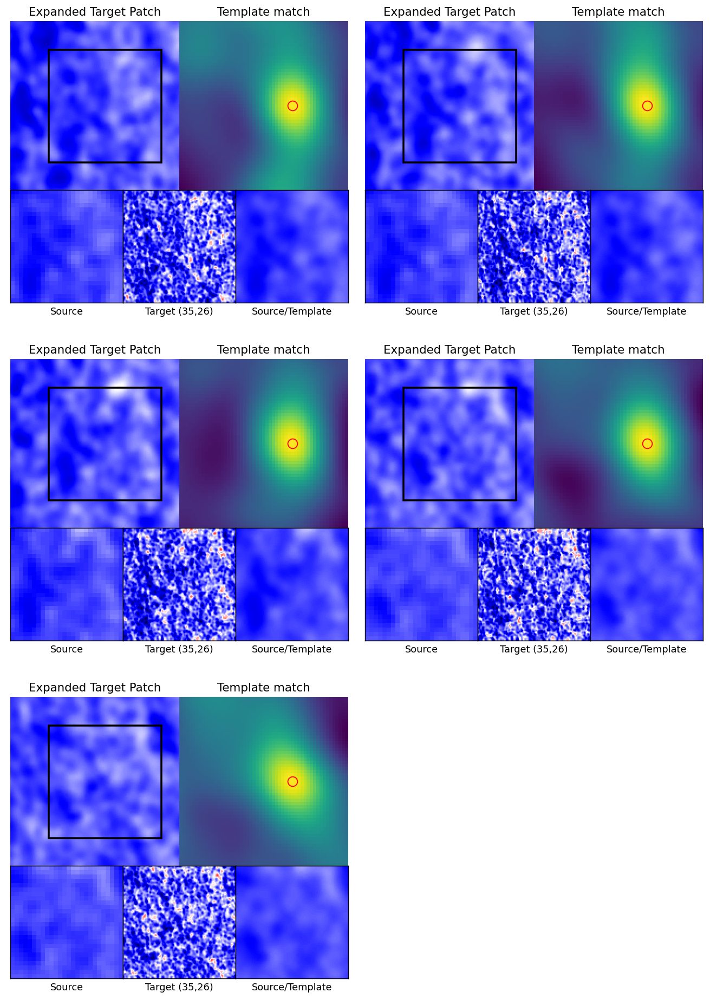

In [60]:
frame=4
inxy=17
inxx=10

lr_patch_size = int(gong_fits_l[0].data.shape[0] / patchscale)
lr_stride = int(gong_fits_l[0].data.shape[0] / stridescale)
hr_patch_size = lr_patch_size * scale_factor
hr_stride = lr_stride * scale_factor

# Size definitions
dpi = 128
pxx = hr_patch_size*2   # Horizontal size of each panel
pxy = hr_patch_size*2   # Vertical size of each panel

nph = 1     # Number of horizontal panels
npv = 1     # Number of vertical panels 

# Padding
padv  = 0  #Vertical padding in pixels
padv2 = 0  #Vertical padding in pixels between panels
padh  = 0 #Horizontal padding in pixels at the edge of the figure
padh2 = 50  #Horizontal padding in pixels between panels

# Figure sizes in pixels
fszv = (npv*pxy + 2*padv + (npv-1)*padv2 )      #Vertical size of figure in pixels
fszh = (nph*pxx + 2*padh + (nph-1)*padh2 )      #Horizontal size of figure in pixels

# Conversion to relative units
ppxx   = pxx/fszh      # Horizontal size of each panel in relative units
ppxy   = pxy/fszv      # Vertical size of each panel in relative units
ppadv  = padv/fszv     #Vertical padding in relative units
ppadv2 = padv2/fszv    #Vertical padding in relative units
ppadh  = padh/fszh     #Horizontal padding the edge of the figure in relative units
ppadh2 = padh2/fszh    #Horizontal padding between panels in relative units


## Start Figure
fig = plt.figure(figsize=(fszh/dpi,fszv/dpi), dpi = dpi)

for frame in range(len(gong_hmi_s_p_l)):
    
    result = match_template(gong_hmi_ts_pp_l[frame][inxy,inxx,:,:], gong_hmi_su_p_l[frame][inxy,inxx,:,:])
    ij = np.unravel_index(np.argmax(result), result.shape)
    x, y = ij[::-1]
    
    
    ax2 = fig.add_axes([ppadh+2.1*(frame%2)*ppxx*(1+2*buffer), ppadv-2*(frame//2)*ppxy*(1+2*buffer), ppxx*(1+2*buffer), ppxy*(1+2*buffer)])

    ax2.imshow(gong_hmi_ts_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
    ax2.set_axis_off()
    ax2.set_title('Expanded Target Patch')
    # highlight matched region
    hcoin, wcoin = gong_hmi_su_p_l[frame][inxy,inxx,:,:].shape
    rect = plt.Rectangle((x, y), wcoin, hcoin, edgecolor='k', facecolor='none', linewidth=2)
    ax2.add_patch(rect)   
    
    
    ax3 = fig.add_axes([ppadh+(2.1*(frame%2)*ppxx+1)*(1+2*buffer), ppadv-2*(frame//2)*ppxy*(1+2*buffer), ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
    
    ax3.imshow(result)
    ax3.set_axis_off()
    ax3.set_title('Template match')
    # highlight matched region
    ax3.autoscale(False)
    ax3.plot(x, y, 'o', markeredgecolor='r', markerfacecolor='none', markersize=10)
    
    
    ax1 = fig.add_axes([ppadh+2.1*(frame%2)*ppxx*(1+2*buffer), ppadv-2*(frame//2)*ppxy*(1+2*buffer)-ppxy, ppxx, ppxy])
    ax1.imshow(gong_hmi_s_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
    ax1.set_yticks([])
    ax1.set_xticks([])
    ax1.set_xlabel('Source')
    
    ax4 = fig.add_axes([ppadh+2.1*(frame%2)*ppxx*(1+2*buffer)+ppxx, ppadv-2*(frame//2)*ppxy*(1+2*buffer)-ppxy, ppxx, ppxy])
    ax4.imshow(gong_hmi_t_pp_l[frame][inxy,inxx, y:y+hr_patch_size, x:x+hr_patch_size], vmin=vmin, vmax=vmax, cmap=current_cmap)
    ax4.set_yticks([])
    ax4.set_xticks([])
    ax4.set_xlabel(f'Target ({x},{y})')
    
    ax5 = fig.add_axes([ppadh+2.1*(frame%2)*ppxx*(1+2*buffer)+2*ppxx, ppadv-2*(frame//2)*ppxy*(1+2*buffer)-ppxy, ppxx, ppxy])
    ax5.imshow(gong_hmi_su_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
    ax5.set_yticks([])
    ax5.set_xticks([])
    ax5.set_xlabel('Source/Template')    
    
# ax1 = fig.add_axes([ppadh, ppadv, ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
# ax1.imshow(gong_hmi_t_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# # ax1.set_axis_off()
# ax1.set_ylabel('Target Padded')
# ax1.set_yticks([])
# ax1.set_xticks([])

# ax2 = fig.add_axes([ppadh+ppxx*(1+2*buffer), ppadv, ppxx*(1+2*buffer), ppxy*(1+2*buffer)])
# ax2.imshow(gong_hmi_ts_pp_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax2.set_ylabel('Target Smooth Padded')
# ax2.set_yticks([])
# ax2.set_xticks([])
# ax2.yaxis.set_label_position("right")


# ax3 = fig.add_axes([ppadh+ppxx*buffer, ppadv-ppxy, ppxx, ppxy])
# ax3.imshow(gong_hmi_t_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax3.set_ylabel('Target')
# ax3.set_yticks([])
# ax3.set_xticks([])


# ax4 = fig.add_axes([ppadh+ppxx*(1+3*buffer), ppadv-ppxy, ppxx, ppxy])
# ax4.imshow(gong_hmi_ts_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax4.set_ylabel('Target Smooth')
# ax4.set_yticks([])
# ax4.set_xticks([])
# ax4.yaxis.set_label_position("right")


# ax5 = fig.add_axes([ppadh+ppxx*buffer, ppadv-2*ppxy, ppxx, ppxy])
# ax5.imshow(gong_hmi_s_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax5.set_ylabel('Source')
# ax5.set_yticks([])
# ax5.set_xticks([])


# ax6 = fig.add_axes([ppadh+ppxx*(1+3*buffer), ppadv-2*ppxy, ppxx, ppxy])
# ax6.imshow(gong_hmi_su_p_l[frame][inxy,inxx,:,:], vmin=vmin, vmax=vmax, cmap=current_cmap)
# ax6.set_ylabel('Source Upscale')
# ax6.set_yticks([])
# ax6.set_xticks([])
# ax6.yaxis.set_label_position("right")


In [62]:
result.shape

(53, 53)

## Feature match MDI patches

Not enough matches are found - 0/2


error: OpenCV(4.5.1) ..\modules\calib3d\src\fundam.cpp:385: error: (-28:Unknown error code -28) The input arrays should have at least 4 corresponding point sets to calculate Homography in function 'cv::findHomography'


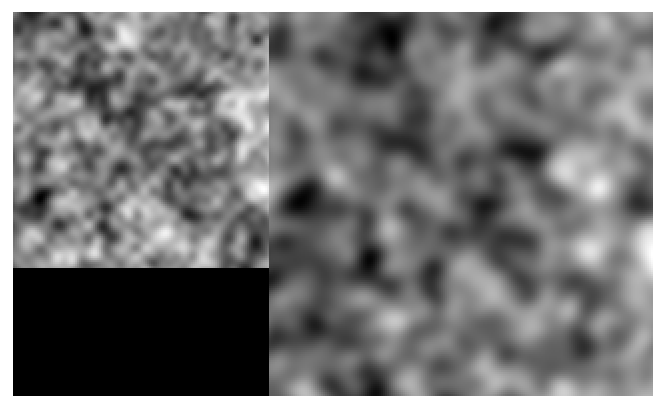

In [48]:
inxy=16
inxx=16

lr_patch_size = int(mdi_fits_l[0].data.shape[0] / patchscale)
lr_stride = int(mdi_fits_l[0].data.shape[0] / stridescale)
hr_patch_size = lr_patch_size * scale_factor
hr_stride = lr_stride * scale_factor

# Size definitions
dpi = 128
pxx = hr_patch_size*2   # Horizontal size of each panel
pxy = hr_patch_size*2   # Vertical size of each panel

nph = 1     # Number of horizontal panels
npv = 1     # Number of vertical panels 

# Padding
padv  = 0  #Vertical padding in pixels
padv2 = 0  #Vertical padding in pixels between panels
padh  = 0 #Horizontal padding in pixels at the edge of the figure
padh2 = 50  #Horizontal padding in pixels between panels

# Figure sizes in pixels
fszv = (npv*pxy + 2*padv + (npv-1)*padv2 )      #Vertical size of figure in pixels
fszh = (nph*pxx + 2*padh + (nph-1)*padh2 )      #Horizontal size of figure in pixels

# Conversion to relative units
ppxx   = pxx/fszh      # Horizontal size of each panel in relative units
ppxy   = pxy/fszv      # Vertical size of each panel in relative units
ppadv  = padv/fszv     #Vertical padding in relative units
ppadv2 = padv2/fszv    #Vertical padding in relative units
ppadh  = padh/fszh     #Horizontal padding the edge of the figure in relative units
ppadh2 = padh2/fszh    #Horizontal padding between panels in relative units

# Lists to store points

src_pts_l = []
dst_pts_l = []


## Pattern Matching definitiuon
sift = cv2.xfeatures2d.SIFT_create(nfeatures=100, contrastThreshold=0.0001)
MIN_MATCH_COUNT = 2
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

## Start Figure
fig = plt.figure(figsize=(fszh/dpi,fszv/dpi), dpi = dpi)

for frame in range(len(mdi_hmi_s_p_l)):
    
    ts_pp_norm = (mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:]-np.mean(mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:]))/np.std(mdi_hmi_ts_pp_l[frame][inxy,inxx,:,:])/4+.5
    ts_pp_norm = cv2.normalize(ts_pp_norm, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    su_p_norm = (mdi_hmi_su_p_l[frame][inxy,inxx,:,:]-np.mean(mdi_hmi_su_p_l[frame][inxy,inxx,:,:]))/np.std(mdi_hmi_su_p_l[frame][inxy,inxx,:,:])/4+.5
    su_p_norm = cv2.normalize(su_p_norm, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    kp1, des1 = sift.detectAndCompute(su_p_norm, None)
    kp2, des2 = sift.detectAndCompute(ts_pp_norm, None)
    
    # find matches by knn which calculates point distance in 128 dim
    matches = flann.knnMatch(des1, des2, k=2)

    # store all the good matches as per Lowe's ratio test.
    good = []
    for m, n in matches:
        if m.distance < 0.7*n.distance:
            good.append(m)

    if len(good) > MIN_MATCH_COUNT:
        src_pts = np.float32(
            [kp1[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
        dst_pts = np.float32(
            [kp2[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)

#         # find homography
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
        matchesMask = mask.ravel().tolist()

        h, w = su_p_norm.shape
        pts = np.float32([[0, 0], [0, h-1], [w-1, h-1],
                          [w-1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(pts, M)  # matched coordinates

        affine = cv2.estimateAffinePartial2D(src_pts[:,0,:]+hr_patch_size*buffer, dst_pts[:,0,:]) 

        map_img = cv2.polylines(
            ts_pp_norm, [np.int32(dst)], True, 255, 3, cv2.LINE_AA)

    else:
        print("Not enough matches are found - %d/%d" %
              (len(good), MIN_MATCH_COUNT))
        matchesMask = None    
        
    draw_params = dict(matchColor=(0, 255, 0),  # draw matches in green color
                       singlePointColor=None,
#                        matchesMask=matchesMask,  # draw only inliers
                       flags=2)

    img3 = cv2.drawMatches(su_p_norm, kp1, ts_pp_norm, kp2,
                           good, None, **draw_params)        

    ax2 = fig.add_axes([ppadh+(frame%2)*ppxx*(2.1+2*buffer), ppadv-(frame//2)*ppxy*(1.1+2*buffer), ppxx*(2+2*buffer), ppxy*(1+2*buffer)])
    
    ax2.imshow(img3, 'gray')
    ax2.set_axis_off()
    
    src_pts_l += (src_pts[:,0,:]+hr_patch_size*buffer).tolist()
    dst_pts_l += dst_pts[:,0,:].tolist()

## Feature match GONG patches

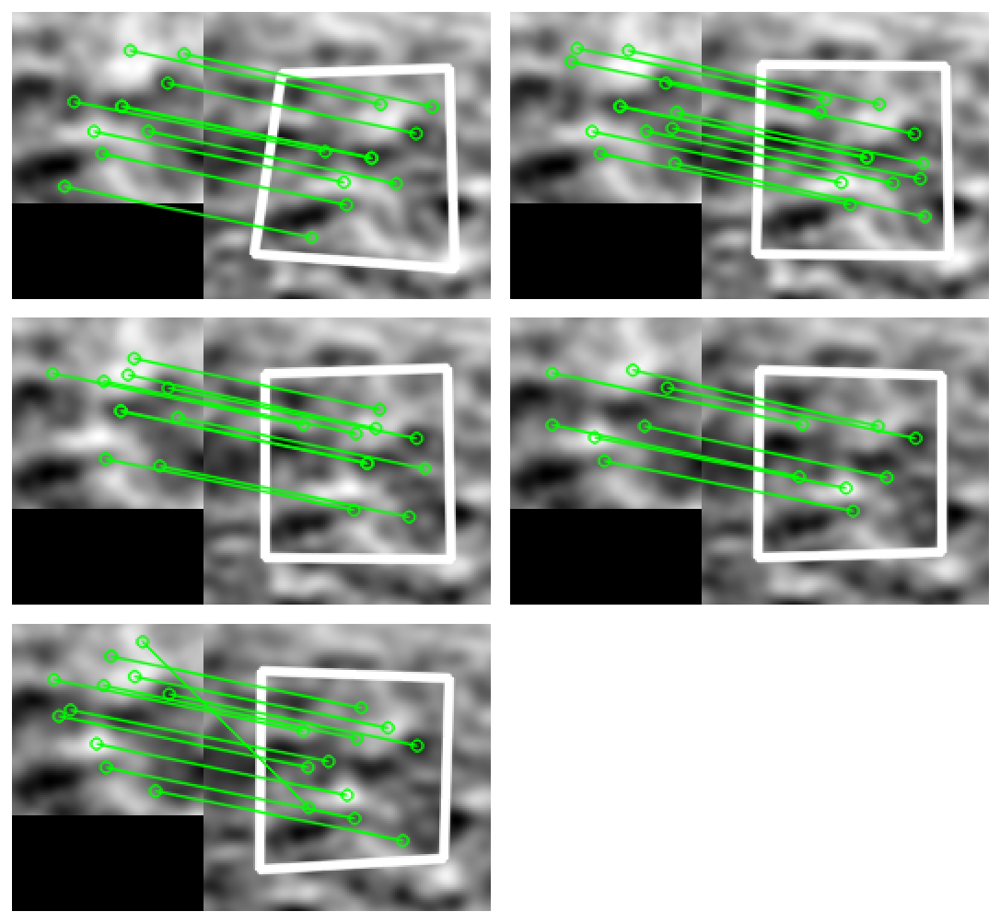

In [42]:
inxy=2
inxx=16

lr_patch_size = int(gong_fits_l[0].data.shape[0] / patchscale)
lr_stride = int(gong_fits_l[0].data.shape[0] / stridescale)
hr_patch_size = lr_patch_size * scale_factor
hr_stride = lr_stride * scale_factor

# Size definitions
dpi = 128
pxx = hr_patch_size*2   # Horizontal size of each panel
pxy = hr_patch_size*2   # Vertical size of each panel

nph = 1     # Number of horizontal panels
npv = 1     # Number of vertical panels 

# Padding
padv  = 0  #Vertical padding in pixels
padv2 = 0  #Vertical padding in pixels between panels
padh  = 0 #Horizontal padding in pixels at the edge of the figure
padh2 = 50  #Horizontal padding in pixels between panels

# Figure sizes in pixels
fszv = (npv*pxy + 2*padv + (npv-1)*padv2 )      #Vertical size of figure in pixels
fszh = (nph*pxx + 2*padh + (nph-1)*padh2 )      #Horizontal size of figure in pixels

# Conversion to relative units
ppxx   = pxx/fszh      # Horizontal size of each panel in relative units
ppxy   = pxy/fszv      # Vertical size of each panel in relative units
ppadv  = padv/fszv     #Vertical padding in relative units
ppadv2 = padv2/fszv    #Vertical padding in relative units
ppadh  = padh/fszh     #Horizontal padding the edge of the figure in relative units
ppadh2 = padh2/fszh    #Horizontal padding between panels in relative units

# Lists to store points

src_pts_l = []
dst_pts_l = []


## Pattern Matching definitiuon
sift = cv2.xfeatures2d.SIFT_create(nfeatures=100, contrastThreshold=0.001)
MIN_MATCH_COUNT = 2
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

## Start Figure
fig = plt.figure(figsize=(fszh/dpi,fszv/dpi), dpi = dpi)

for frame in range(len(gong_hmi_s_p_l)):
    
    ts_pp_norm = (gong_hmi_ts_pp_l[frame][inxy,inxx,:,:]-np.mean(gong_hmi_ts_pp_l[frame][inxy,inxx,:,:]))/np.std(gong_hmi_ts_pp_l[frame][inxy,inxx,:,:])/4+.5
    ts_pp_norm = cv2.normalize(ts_pp_norm, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)

    su_p_norm = (gong_hmi_su_p_l[frame][inxy,inxx,:,:]-np.mean(gong_hmi_su_p_l[frame][inxy,inxx,:,:]))/np.std(gong_hmi_su_p_l[frame][inxy,inxx,:,:])/4+.5
    su_p_norm = cv2.normalize(su_p_norm, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    kp1, des1 = sift.detectAndCompute(su_p_norm, None)
    kp2, des2 = sift.detectAndCompute(ts_pp_norm, None)
    
    # find matches by knn which calculates point distance in 128 dim
    matches = flann.knnMatch(des1, des2, k=2)

    # store all the good matches as per Lowe's ratio test.
    good = []
    for m, n in matches:
        if m.distance < 0.7*n.distance:
            good.append(m)

    if len(good) > MIN_MATCH_COUNT:
        src_pts = np.float32(
            [kp1[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
        dst_pts = np.float32(
            [kp2[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)

#         # find homography
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
        matchesMask = mask.ravel().tolist()

        h, w = su_p_norm.shape
        pts = np.float32([[0, 0], [0, h-1], [w-1, h-1],
                          [w-1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(pts, M)  # matched coordinates

        affine = cv2.estimateAffinePartial2D(src_pts[:,0,:]+hr_patch_size*buffer, dst_pts[:,0,:]) 

        map_img = cv2.polylines(
            ts_pp_norm, [np.int32(dst)], True, 255, 3, cv2.LINE_AA)

    else:
        print("Not enough matches are found - %d/%d" %
              (len(good), MIN_MATCH_COUNT))
        matchesMask = None    
        
    draw_params = dict(matchColor=(0, 255, 0),  # draw matches in green color
                       singlePointColor=None,
#                        matchesMask=matchesMask,  # draw only inliers
                       flags=2)

    img3 = cv2.drawMatches(su_p_norm, kp1, ts_pp_norm, kp2,
                           good, None, **draw_params)        

    ax2 = fig.add_axes([ppadh+(frame%2)*ppxx*(2.1+2*buffer), ppadv-(frame//2)*ppxy*(1.1+2*buffer), ppxx*(2+2*buffer), ppxy*(1+2*buffer)])
    
    ax2.imshow(img3, 'gray')
    ax2.set_axis_off()
    
    src_pts_l += (src_pts[:,0,:]+hr_patch_size*buffer).tolist()
    dst_pts_l += dst_pts[:,0,:].tolist()

In [45]:
affine = cv2.estimateAffinePartial2D(np.array(src_pts_l), np.array(dst_pts_l))
affine[0]

array([[ 0.9893509 , -0.01184787,  1.53983267],
       [ 0.01184787,  0.9893509 , -4.2356315 ]])

In [46]:
theta = np.arctan2(affine[0][1,0],affine[0][0,0])
theta*180/np.pi

0.6861072097122901

In [47]:
s = affine[0][0,0]/np.cos(theta)
s

0.9894218366152018